# Project 2 Programming for Data Analysis Winter 2023 

**Author: Nur Bujang**

project2.ipynb
***

## Table of Content for project2.ipynb

* Project Instruction

* Project Title: An Analysis Of Paleo-Present Climate Data

* Abstract

* 1.0 Background

    * 1.1 Climate Change

    * 1.2 Global Warming

    * 1.3 Links Between CO<sub>2</sub>, Air Temperature, CH<sub>4</sub> And Precipitation In Climate Change

        * 1.3.1 CO<sub>2</sub>

        * 1.3.2 Air Temperature

        * 1.3.3 CH<sub>4</sub>

        * 1.3.4 Ireland's Temperature And Precipitation

* 2.0 Methods and Implementation

    * 2.1 CO<sub>2</sub> vs Temperature Anomaly From 822kya To Present

        * 2.1.1 CO<sub>2</sub>

        * 2.1.2 Temperature

    * 2.2 CH<sub>4</sub> Anomaly From 822kya To Present

    * 2.3 Irish Context: Climate Change Signal

        * 2.3.1 Ireland's Temperature

        * 2.3.2 Ireland's Precipitation

    * 2.4 Data Fusion To csv And json

    * 2.5 Analysis Of CO<sub>2</sub>, Temperature, CH<sub>4</sub> and Precipitation

        * 2.5.1 Pearson Correlation

        * 2.5.2 Trend Analysis
            
            * 2.5.2.1 Mann-Kendall Test With MK Z Statistic

            * 2.5.2.2 Fast Fourier Transform (FFT)

            * 2.5.2.3 Multi-Seasonal Time Series Decomposition for Ireland's Temperature and Precipitation

            * 2.5.2.4 Ireland's Annual Temperature Signal to Noise Ratio (SNR)

        * 2.5.3 Temporal Lead/Lag Analysis

            * 2.5.3.1 The Granger Causality Test

            * 2.5.3.2 Autocorrelation Function (ACF) and Partial Autocorrelation Function (PACF)

            * 2.5.3.3 Time Lagged Cross-Correlation Analysis

        * 2.5.4 Global Temperature Anomaly Prediction

        * 2.5.5 Accelerated Warming

* 4.0 Conclusions

* 5.0 References

### Project Instruction:

Analyse CO2 vs Temperature Anomaly from 800kyrs – present.

Examine one other (paleo/modern) features (e.g. CH4 or polar ice-coverage)

Examine Irish context: Climate change signals: (see Maynooth study: The emergence of a climate change signal in long-term Irish meteorological observations - ScienceDirect)

Fuse and analyse data from various data sources and format fused data set as a pandas dataframe and export to csv and json formats

For all of the above variables, analyse the data, the trends and the relationships between them (temporal leads/lags/frequency analysis).

Predict global temperature anomaly over next few decades (synthesise data) and compare to published climate models if atmospheric CO2 trends continue

Comment on accelerated warming based on very latest features (e.g. temperature/polar-ice-coverage)

# Project Title: **An Analysis Of Paleo-Present Climate Data**

## Abstract

A complete dataset containing CO<sub>2</sub> level (ppmv), temperature (°C), temperature anomaly (°C), CH<sub>4</sub> (ppbv) from 822kya to present and Ireland's temperature (°C) and precipitation (mm) was saved into df_all.csv and df_all.json. Luthi et al. 2008's CO<sub>2</sub> dataset is not a subset of the IPCC Report, with the latter showing the presence of gas age revision. Time (Gas age) adjustment in AICC2012 shifted the temperature values from 822kya to 400kya when compared with NOAA NCEI dataset. Temperature anomaly from Jouzel-AICC paper was derived from NOAA. Pearson Correlation shows that CO<sub>2</sub> has a high positive correlation with CH<sub>4</sub> and temperature, and a high negative correlation with Irish temperature. The Mann-Kendall Test shows significant increasing trends in CO<sub>2</sub>, temperature, temperature anomaly and CH<sub>4</sub>, while Ireland's temperature and precipitation show decreasing trends over time. Fast Fourier Transform (FFT) shows that for CO<sub>2</sub>, CH<sub>4</sub> and temperature, there is a significant dominant frequency occuring every 10000 years and a lesser magnitude one every 25000 years. Multi-Seasonal Time Series Decomposition for Ireland's temperature and precipitation shows the presence of the seasonal effect, but the temperature and precipitation have remained relatively constant over the years. Ireland's Temperature Signal to Noise Ratio (SNR) at present are mostly categorised as "inconceivable" (SNR>5) when compared to the early‐industrial period of 1850 to 1900. The Granger Causality Test indicates a a causal relationship between CO<sub>2</sub> and temperature, between temperature and CH<sub>04</sub>, and CO<sub>2</sub> correlates with a rise in CH<sub>4</sub>. Autocorrelation Function (ACF) values are significant for temperature, CO<sub>2</sub> and CH<sub>4</sub> for lags up to 12000years, 15000 years and 11000 years, respectively. Partial Autocorrelation Function (PACF) values for temperature, CO<sub>2</sub> and CH<sub>4</sub> are statistically significant until lag=1000 years. The autocorrelation between Irish temperature and precipitation and their lagged versions decrease over time. Time Lagged Cross-Correlation Analysis shows that temperature increase is followed by CO<sub>2</sub> increase, CO<sub>2</sub> increase is followed by CH<sub>4</sub> increase and CH<sub>4</sub> increase increase is followed by temperature increase. Irish data shows that temperature increase is followed by precipitation increase. Global temperature anomaly prediction shows that it will increase over time if the atmospheric CO<sub>2</sub> trend keeps increasing. There is an accelerated increase of CO<sub>2</sub>, temperature, temperature anomaly, CH<sub>4</sub> and Ireland's temperature and precipitation over the last 200 years that is outside the normal range, which indicates that there is a signal happening in the data and not just some random effects of noise. There is no indication of accelerated warming based solely on data from the last 5 years alone. In summary, evidence of climate change depends on the analysis being performed, the limit of settings within the analysis, the range of time period in the analysis, and the base period used for comparison.

## 1.0 Background

### 1.1 Climate Change

Climate is characterized by long-term patterns in temperature, humidity, winds, rainfall and extreme weather frequency. Climate change refers to significant and persistent changes in the local, regional and global climate pattern (NASA, 2023b). According to United Nations (2023) and NASA (2023a), the impacts of climate change include rising sea levels, catastrophic and frequent floods and droughts and melting polar ice. 

### 1.2 Global Warming

Global warming is a specific aspect of climate change defined by the abnormally-accelerated increase in Earth's average surface temperature due to human activity (Riebeek, 2010). This surface temperature increase has been observed since the pre-industrial period, mostly due to greenhouse gasses from fossil fuel burning (NASA, 2023b). According to United States Environmental Protection Agency (2017), examples of greenhouse gases include carbon dioxide(CO<sub>2</sub>), nitrous oxide(N<sub>2</sub>O), methane (CH<sub>4</sub>) and sulfur hexafluoride (SF<sub>6</sub>).

### 1.3 Links Between CO<sub>2</sub>, Air Temperature, CH<sub>4</sub> And Precipitation In Climate Change

The interrelationships between atmospheric carbon dioxide (CO<sub>2</sub>), methane (CH<sub>4</sub>), temperature, and precipitation is intricate and play a vital role in the complex system of climate change. The greenhouse gases (CO<sub>2</sub> and CH<sub>4</sub>) trap heat in the Earth's atmosphere by absorbing and re-emitting infrared radiation back toward Earth's surface (www.ces.fau.edu, n.d.). This Greenhouse Effect results in a rise in average global temperatures, impacting various components of the Earth's climate system. 

These warmer temperatures affect the atmospheric circulation and moisture patterns through intensification of the water cycle where warmer air holds more moisture (Wikipedia, 2023). This shifts in rainfall and precipitation distribution patterns leads to intense and frequent extreme weather events, such as heavy rainfall, storms, heatwaves and droughts (Understanding Global Change, n.d., Dore, 2005, www.eea.europa.eu, n.d.).

Changes in temperature and precipitation can also create an ice-albedo feedback, where the reduction of Earth's albedo (reflectivity) from ice and snow melt caused by warmer temperatures leads to more absorption of solar radiation, thus further warming the planet (CIRES Education and Outreach at CU Boulder, n.d.).

#### 1.3.1 Atmospheric CO<sub>2</sub>

According to Berner (1991), atmospheric CO<sub>2</sub> dictates the world climate on geological time magnitude. Results from ice-core data show that atmospheric CO<sub>2</sub> concentrations were significantly lower between 650kyr and 750kyr compared to the present day (Lüthi et al., 2008). A few years later, Bereiter et al. (2015) followed up with a corrected 442–816kyr portion of the EPICA Dome C CO<sub>2</sub> data.

According to Hertzberg and Schreuder (2016), there has been a steady increase in the average atmospheric CO<sub>2</sub> concentration from 280ppmv to 400ppmv over the last two centuries. Data from atmospheric CO<sub>2</sub> concentration collected at at Mauna Loa Observatory, Hawaii shows a linear trend from 315ppm in 1959 to 425ppm in 2022 (NOAA, 2023).

#### 1.3.2 Air Temperature

Results from high-resolution deuterium measurements of ice core data show that based on 100-year mean values over the past 800kyr, surface temperature increased ~15°C (Jouzel et al., 2007). Parrenin et al. (2013) found that atmospheric CO<sub>2</sub> and surface air temperature move synchronously for most part from 800kyr to the present time eventhough Fischer et al. (1999), Monnin et al. (2001) and Lourantou et al. (2010) reported that atmospheric CO<sub>2</sub> lags behind temperature by a few hundred years. However, Hertzberg and Schreuder (2016) noticed that temperature changes always precedes atmospheric CO<sub>2</sub> changes by several hundred to a thousand years, thus suggesting that temperature change causes CO<sub>2</sub>, and not vice versa. 

Chen et al. (2023) reported a correlation between atmospheric CO<sub>2</sub> and temperature. Earlier, Kang and Larsson (2013) reported a feedback system where temperature and CO<sub>2</sub> Granger-cause each other in both directions.

#### 1.3.3 Atmospheric CH<sub>4</sub>

Petit et al. (1999) reported that CO<sub>2</sub> and CH<sub>4</sub> concentrations follow the same trend for each glacial cycle. Monnin et al. (2001) reported that eventough the reasons behind CH<sub>4</sub> concentrations variations are different from CO<sub>2</sub>, in general, CO<sub>2</sub> and CH<sub>4</sub> increase are parallel with each other. There is also a high correlation between temperature and CH<sub>4</sub> in the past (Spahni et al., 2005). Using Granger causality analysis, temperature, CO<sub>2</sub> and CH<sub>4</sub> bi-directionally Granger-cause each other, where one's increase causes an increase in the other in a feedback system (Larsson and Persson, 2023).

#### 1.3.4 Ireland's Temperature And Precipitation

An analysis of a homogenized Island of Ireland Precipitation (IIP) data from 1850–2010 to study long-term rainfall series in Ireland found an increasing pattern or upward trend in the amount of precipitation (rainfall or snowfall) during the winter months, while a negative or decreasing pattern was found in the amount of precipitation during the summer months (Noone et al., 2016). 

Long-term air temperature series data for Ireland between 1831-1968 was reconstructed by Mateus, Potito and Curley (2020) and between 1885–2018 (Mateus and Potito, 2021). Subsequent analysis between 1885 to 2018 found significant air temperature increase in all seasons, especially spring and autumn and significant air temperature decrease during cold days, cold nights and frost days (Mateus and Potito, 2022).

Later, Murphy et al. (2023a) found that Dublin-based stations show a maximum increase of 1.14°C in the annual mean temperature for every 1°C increase in the global mean surface temperature and increase in extremely heavy rainfall were recorded for 30% of stations. Such temperature increase would result in higher risk of river and groundwater flooding in Ireland (Murphy et al., 2023b).

## 2.0 Methods and Implementation

### 2.1 CO<sub>2</sub> vs Temperature Anomaly From 822kya To Present

#### 2.1.1 CO<sub>2</sub>

Data for CO<sub>2</sub> was a composite of Chen et al. (2023) and Lan, Tans and Thoning (2023).

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sb
import pymannkendall as mk
from scipy.fft import fft, fftfreq
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from scipy.signal import correlate
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from statsmodels.nonparametric.smoothers_lowess import lowess
import datetime
import warnings
warnings.filterwarnings('ignore')

#### CO<sub>2</sub> pre 2001

CO<sub>2</sub> was imported from IPCC report (Chen et al., 2023), and the relevant columns were selected with iloc (Pandas.pydata.org iloc, n.d.).

In [2]:
df_co2_pre2001 = pd.read_csv('data/co2/coipcc800kyr-2001.csv')
df_co2_pre2001.head(3)

,Gasage (yr BP),co2 (ppmv),sigma mean CO2 (ppmv),Unnamed: 3,Unnamed: 4,year
0,-51.03,368.02,0.06,NaN,NaN,2001.03
1,-48.00,361.78,0.37,NaN,NaN,1998.00
2,-46.28,359.65,0.10,NaN,NaN,1996.28


In [3]:
df_co2_pre2001 = df_co2_pre2001.iloc[:, :2].copy() # select columns 1 and 2 only

Because negative years do not exist, numpy negative was used because the age scale was years before 1950 (Numpy.org numpy.negative, n.d.).

In [4]:
df_co2_pre2001['year'] = (np.negative(df_co2_pre2001['Gasage (yr BP) '])
                          + 1950)

Column was renamed as shown in Pandas.pydata.org rename (n.d.).

In [5]:
df_co2_pre2001.rename(columns={'co2 (ppmv)': 'co2 ppmv ipcc'}, 
                    inplace=True)
df_co2_pre2001 = df_co2_pre2001[['year','co2 ppmv ipcc']].copy()

In [6]:
df_co2_luthi = pd.read_csv('data/co2/coluthi.csv')
df_co2_luthi.head(3)

,EDC3_gas_a (yr),co2 (ppmv)
0,137,280.4
1,268,274.9
2,279,277.9


In [7]:
df_co2_luthi.rename(columns={'co2 (ppmv)': 'co2 ppmv luthi'}, 
                    inplace=True)
df_co2_luthi['year'] = (np.negative(df_co2_luthi['EDC3_gas_a (yr)'])
                          + 1950)
df_co2_luthi = df_co2_luthi[['year','co2 ppmv luthi']].copy()

Pandas concat was used to combine dataframe objects (Pandas.pydata.org concat, n.d.).

In [8]:
df_co2_ipcc_vs_luthi = pd.concat([df_co2_pre2001, 
                        df_co2_luthi
])
df_co2_ipcc_vs_luthi.head(3)

,year,co2 ppmv ipcc,co2 ppmv luthi
0,2001.03,368.02,NaN
1,1998.00,361.78,NaN
2,1996.28,359.65,NaN


A scatter plot was generated to visualise the data according to matplotlib.org scatter (n.d.) and matplotlib.org legend (n.d.). 

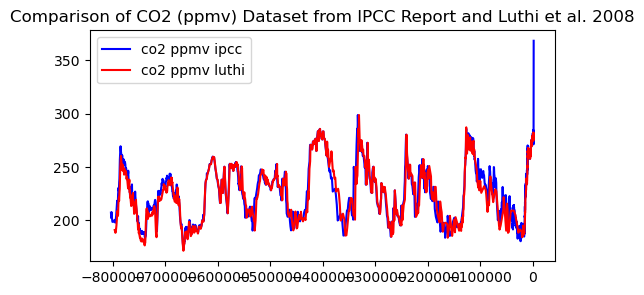

In [9]:
# px.scatter(df_co2_ipcc_vs_luthi.sort_values('year', ascending=True), 
#         x='year', 
#         y=['co2 ppmv ipcc', 'co2 ppmv luthi'], 
#         width=600,
#         title="Comparison of CO2 (ppmv) Dataset from IPCC Report <br> and Luthi et al. 2008"
#         )

fig1, ax1 = plt.subplots(figsize=(6, 3))
ax2 = ax1
ax1.plot(df_co2_ipcc_vs_luthi['year'], df_co2_ipcc_vs_luthi['co2 ppmv ipcc'], label='co2 ppmv ipcc', c='b')
ax2.plot(df_co2_ipcc_vs_luthi['year'], df_co2_ipcc_vs_luthi['co2 ppmv luthi'], label='co2 ppmv luthi', c='r')
ax1.legend()
plt.title("Comparison of CO2 (ppmv) Dataset from IPCC Report and Luthi et al. 2008") ;

The CO<sub>2</sub> dataset from Luthi et al. 2008 is not a subset of the IPCC Report. Values between 17.80kyr and 111.86kyr are different from one another. Similarities in CO<sub>2</sub> values between the two dataset suggests a gas age revision in IPCC Report, as seen from 154.5-218.2kyr, 332.9-389.9kyr and 689.6-822kya.

In [10]:
# Standardise CO2 columns

df_co2_pre2001.rename(columns={'co2 ppmv ipcc': 'co2 ppmv'}, 
                    inplace=True)

df_co2_luthi.rename(columns={'co2 ppmv luthi': 'co2 ppmv'}, 
                    inplace=True)

#### CO<sub>2</sub> post 2001

In [11]:
df_co2_post2001 = pd.read_csv('data/co2/conoaa1979-2022.csv', skiprows=37)
df_co2_post2001.head(3)

,year,mean,unc
0,1979,336.85,0.11
1,1980,338.91,0.07
2,1981,340.11,0.09


In [12]:
df_co2_post2001 = df_co2_post2001.iloc[:, :2].copy()
df_co2_post2001.rename(columns={'mean': 'co2 ppmv'}, inplace=True)

#### CO<sub>2</sub> complete

The complete CO<sub>2</sub> dataset was merged from three sources using Pandas.pydata.org merge (n.d.).

In [13]:
df_co2_all = [df_co2_pre2001[['year', 'co2 ppmv']].rename(columns={'co2 ppmv': 'co2 ppmv pre2001'}), 
               df_co2_luthi[['year', 'co2 ppmv']].rename(columns={'co2 ppmv': 'co2 ppmv luthi'}), 
               df_co2_post2001[['year','co2 ppmv']].rename(columns={'co2 ppmv': 'co2 ppmv post2001'})
               ]

In [14]:
df_co2_all_0_1 = df_co2_all[0].merge(df_co2_all[1], left_on='year', right_on='year', how='outer')
df_co2_all_0_2 = df_co2_all_0_1.merge(df_co2_all[2], left_on='year', right_on='year', how='outer')

After the column names were defined, a column was created containing the mean CO<sub>2</sub> values from all three sources (Pandas.pydata.org mean, n.d.).

In [15]:
co2_columns = [c for c in df_co2_all_0_2.columns if c.startswith('co2')]
co2_columns

['co2 ppmv pre2001', 'co2 ppmv luthi', 'co2 ppmv post2001']

In [16]:
df_co2_all_0_2['co2 mean'] = df_co2_all_0_2[co2_columns].mean(axis=1)

Because it is impossible to have a negative time value, the column year was sorted according to Pandas.pydata.org sort_values (n.d.).

In [17]:
df_co2_all_0_2.sort_values('year', inplace=True)
df_co2_all_0_2.reset_index(drop=True, inplace=True)
df_co2_all_0_2.head(3)

,year,co2 ppmv pre2001,co2 ppmv luthi,co2 ppmv post2001,co2 mean
0,-803718.87,207.29,NaN,NaN,207.29
1,-803182.44,202.23,NaN,NaN,202.23
2,-802572.67,204.86,NaN,NaN,204.86


The oldest time point at 819888 before year zero (821911 years before 2023) from Jouzel et al. (2007)-AICC dataset was reset as time 0.

In [18]:
# reset based on 821911 years ago as 0

df_co2_all_0_2['year reset'] = df_co2_all_0_2['year'] + 16169.13 + np.negative(df_co2_all_0_2['year'].min()) 
df_co2_all_0_2.head(3)

,year,co2 ppmv pre2001,co2 ppmv luthi,co2 ppmv post2001,co2 mean,year reset
0,-803718.87,207.29,NaN,NaN,207.29,16169.13
1,-803182.44,202.23,NaN,NaN,202.23,16705.56
2,-802572.67,204.86,NaN,NaN,204.86,17315.33


In [19]:
df_co2_all_0_2.set_index('year reset', inplace=True, drop=True)
df_co2_all_0_2.head(3)

,year,co2 ppmv pre2001,co2 ppmv luthi,co2 ppmv post2001,co2 mean
year reset,,,,,
16169.13,-803718.87,207.29,NaN,NaN,207.29
16705.56,-803182.44,202.23,NaN,NaN,202.23
17315.33,-802572.67,204.86,NaN,NaN,204.86


In [20]:
type(df_co2_all_0_2) 

pandas.core.frame.DataFrame

#### 2.1.2 Temperature

Data for temperature was a composite of data from National Centers for Environmental Information (NOAA NCEI, n.d.), Jouzel and Masson‐Delmotte (2007) versions of Jouzel et al. (2007) and NOAA NCEI (2023b). The 20th century global average temperature is 13.9°C (57.0°F) NOAA NCEI (2023a).

In the tempnoaajoudelt2000-801662 dataset (Jouzel and Masson‐Delmotte, 2007), $\delta$ T is the temperature difference from the average of the last 1000 years in °C, with corrections (Bintanja, van de Wal and Oerlemans, 2005, Parrenin et al., 2007). The dataset tempjouzelaicc2000-800kyr from AICC12 has a different ice core chronology and timescale.

#### Temperature pre 2005

In [21]:
# Temperature from Jouzel-AICC

df_temp_joai = pd.read_csv('data/at/tempjouzelaicc2005-800kyr.csv')
df_temp_joai.head(3)

,bag,ztop,EDC3béta,AICC2012,deutfinal,temp,acc-EDC3beta
0,1,0.00,-50.00000,-55.000000,NaN,218.3,3.105321
1,2,0.55,-43.55977,-50.513333,NaN,218.3,3.104805
2,3,1.10,-37.44019,-46.026667,NaN,218.3,3.104404


In [22]:
df_temp_joai.rename(columns={'temp': 'temp k'}, inplace=True)

df_temp_joai['temp c'] = df_temp_joai['temp k'] - 273.15

df_temp_joai['edc year'] = (np.negative(df_temp_joai['EDC3béta'])
                          + 1950)

df_temp_joai['aicc year'] = (np.negative(df_temp_joai['AICC2012'])
                          + 1950)

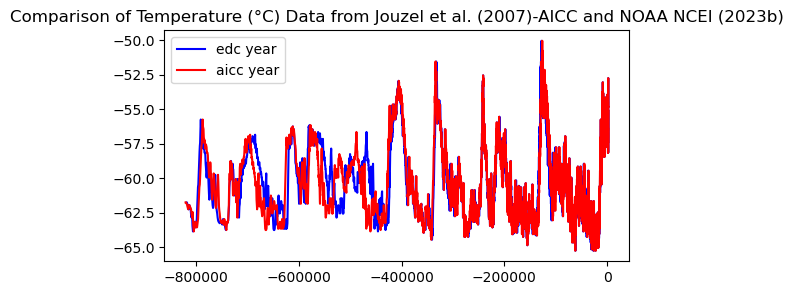

In [23]:
# px.scatter(df_temp_joai, x=['edc year', 'aicc year'], y='temp c', width=600, 
#            title="Comparison of Temperature (°C) Data from Jouzel et al. (2007)-AICC <br> and NOAA NCEI (2023b)"
#            )

fig,ax = plt.subplots(figsize=(6, 3))
ax.plot(df_temp_joai['edc year'], df_temp_joai['temp c'], label='edc year', c='b')
ax.plot(df_temp_joai['aicc year'], df_temp_joai['temp c'], label='aicc year', c='r')
ax.legend()
plt.title("Comparison of Temperature (°C) Data from Jouzel et al. (2007)-AICC and NOAA NCEI (2023b)");

Time (Gas age) adjustment in AICC2012 shifted the temperature values from 822kya to 400kya. The temperature and time from 400kya to present remain the same.

Henceforth, gas age from AICC will be used as time unit.

In [24]:
df_temp_joai.rename(columns={'aicc year': 'year'}, inplace=True)

df_temp_joai.sort_values(['year'], inplace=True)

In [25]:
# Temperature from NOAA (NOAA NCEI, n.d.)

df_temp_noaanom = pd.read_csv('data/at/tempnoaajoudelt2000-801662.txt', skiprows = 91)
df_temp_noaanom.head(3)

,Bag ztop Age Deuterium anom c
0,1 0 -50.00000
1,2 0.55 -43.54769
2,3 1.1 -37.41829


The column names (string) in the text file was split according to Pandas.pydata.org Series.str.split (n.d.).

In [26]:
columns = df_temp_noaanom.columns.str.split()[0][:-1]
anom_split = df_temp_noaanom[' Bag         ztop          Age         Deuterium    anom c'].str.split()

In [27]:
for index, col in enumerate(columns):
    
    if col == 'anom':
        col = 'anom c'
    
    df_temp_noaanom[col] = anom_split.str[index]

The strings were then converted into floats using astype (Datatofish.com, 2021, Pandas.pydata.org astype, n.d.).

In [28]:
df_temp_noaanom = df_temp_noaanom.iloc[:, 1:].copy() # select everything but exclude column 1

df_temp_noaanom = df_temp_noaanom.astype(float)

df_temp_noaanom['year'] = (np.negative(df_temp_noaanom['Age']) + 1950)

#### Temperature post 2005

In [29]:
df_temp_post2005 = pd.read_csv('data/at/tempglobalanomnoaa1850-2022.csv', skiprows = 4)
df_temp_post2005.head(3)

,Year,Anomaly
0,1850,-0.37
1,1851,-0.12
2,1852,-0.15


In [30]:
df_temp_post2005.rename(columns={'Year': 'year', 
                             'Anomaly': 'anom c'}, 
                             inplace=True)

#### Because the temperature average for 1901-2000 is 13.9°C (NOAA NCEI, 2023a):

In [31]:
df_temp_post2005['temp c'] = df_temp_post2005['anom c'] + 13.9

In [32]:
df_temp_all = [df_temp_joai[['year', 'temp c']],
               df_temp_noaanom[['year', 'anom c']], 
               df_temp_post2005[['year', 'anom c', 'temp c']].rename(columns=
                                                                     {'anom c': 'modern anom c', 
                                                                      'temp c': 'modern temp c'} )
               ]

In [33]:
df_temp_all[0]['year'] = df_temp_all[0]['year'].round(0).astype(int)
df_temp_all[1]['year'] = df_temp_all[1]['year'].round(0).astype(int)

df_temp_all_0_1 = df_temp_all[0].merge(df_temp_all[1], 
                    left_on='year', right_on='year', 
                    how='outer')
df_temp_all_0_1.head(3)

,year,temp c,anom c
0,-819888,-61.75,NaN
1,-818819,-61.75,NaN
2,-817750,-61.85,NaN


In [34]:
df_temp_all_0_2 = df_temp_all_0_1.merge(df_temp_all[2], 
                                        left_on='year', right_on='year', 
                                        how='outer')

df_temp_all_0_2.sort_values('year', inplace=True)
df_temp_all_0_2.reset_index(drop=True, inplace=True)

The oldest time point at 819888 before year zero (821911 years before 2023) from Jouzel et al. (2007)-AICC dataset was reset as time 0.

In [35]:
# reset based on 821911 years ago as 0

df_temp_all_0_2['year resetcol'] = df_temp_all_0_2['year'] + np.negative(df_temp_all_0_2['year'].min())
df_temp_all_0_2.head(3)


,year,temp c,anom c,modern anom c,modern temp c,year resetcol
0,-819888,-61.75,NaN,NaN,NaN,0
1,-818819,-61.75,NaN,NaN,NaN,1069
2,-817750,-61.85,NaN,NaN,NaN,2138


A lambda function was used to pass a function to another function (Sharma, 2020, GeeksforGeeks, 2020). It was applied on a Pandas.Period with yearly frequency (Pandas.pydata.org Period n.d., Pandas.pydata.org Time series, n.d.).

In [36]:
df_temp_all_0_2['year reset'] = df_temp_all_0_2['year resetcol'].apply(
                                         lambda x: pd.Period(year=x, freq='Y'))
df_temp_all_0_2.set_index('year reset', inplace=True, drop=True)
df_temp_all_0_2.head(3)

,year,temp c,anom c,modern anom c,modern temp c,year resetcol
year reset,,,,,,
0,-819888,-61.75,NaN,NaN,NaN,0
1069,-818819,-61.75,NaN,NaN,NaN,1069
2138,-817750,-61.85,NaN,NaN,NaN,2138


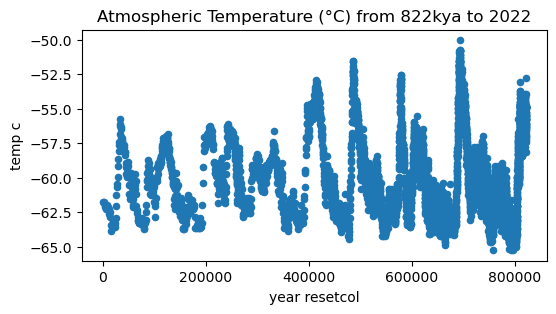

In [37]:
df_temp_all_0_2.reset_index().plot.scatter(
    x='year resetcol', 
    y='temp c',figsize=(6,3)
    )
plt.title("Atmospheric Temperature (°C) from 822kya to 2022");

The temperature anomaly from paleo datasets uses temperature difference from the average of the last 1000 years. For time series frequency conversion and resampling, df.resample was used (GeeksforGeeks, 2018, Pandas.pydata.org resample, n.d., Mishra, 2021).

In [38]:
resampled = df_temp_all_0_2.resample(
    '1000Y')['temp c'].mean().to_frame(name='temp c mean')
resampled.head(3)

,temp c mean
year reset,
0,-61.75
1000,-61.75
2000,-61.85


In [39]:
df_temp_all_0_2.index.freq, resampled.index.freq

(<YearEnd: month=12>, <1000 * YearEnds: month=12>)

In [40]:
resampled_copy = resampled.copy()
resampled_copy.index = resampled_copy.index.asfreq(df_temp_all_0_2.index.freq)
print(resampled_copy.index.freq)

<YearEnd: month=12>


The complete temperature dataset was merged using Pandas.pydata.org merge (n.d.).

In [41]:
df_with_mean = df_temp_all_0_2.merge(resampled_copy,left_index=True,
                                     right_index=True, 
                                     how='outer')
df_with_mean.head(3)

,year,temp c,anom c,modern anom c,modern temp c,year resetcol,temp c mean
year reset,,,,,,,
0,-819888.0,-61.75,NaN,NaN,NaN,0.0,NaN
999,NaN,NaN,NaN,NaN,NaN,NaN,-61.75
1069,-818819.0,-61.75,NaN,NaN,NaN,1069.0,NaN


In [42]:
df_with_mean['cal anom c'] = df_with_mean['temp c'] - df_with_mean['temp c mean']

Because the dataset has many missing values, Pandas.pydata.org ffill (n.d.) was used to use the last value to replace the next missing value.

In [43]:
df_with_mean['temp c ffill'] = df_with_mean['temp c'].ffill(axis=0)
df_with_mean['temp c mean ffill'] = df_with_mean['temp c mean'].ffill(axis=0)

df_with_mean.index = df_with_mean.index.astype(str).astype(float)

It was assumed that the NOAA anomaly dataset was derived from the Jouzel-AICC dataset.

In [44]:
df_with_mean['temp cmeanf anom'] = df_with_mean['anom c'] + df_with_mean['temp c mean ffill']

df_with_mean['anom c alt'] = df_with_mean['temp cmeanf anom'] - df_with_mean['temp c ffill']

A scatter plot was generated to visualise the data according to Plotly.com express.scatter (n.d.) and Plotly.com Scatter Plots (n.d.). 

In [45]:
px.scatter(df_with_mean, 
           x=df_with_mean.index,
           y=['anom c', 'anom c alt', 'temp c ffill', 'temp cmeanf anom'],
           width=600, 
           title = "Comparison of Atmospheric Temperature (°C) and Anomaly (°C) <br> from the Jouzel-AICC and NOAA Dataset")

# fig,ax = plt.subplots(figsize=(6, 3))
# ax.plot(df_with_mean.index, df_with_mean['anom c'], label='anom c', c='b')
# ax.plot(df_with_mean.index, df_with_mean['anom c alt'], label='anom c alt', c='r')
# ax.plot(df_with_mean.index, df_with_mean['temp c ffill'], label='temp c ffill', c='g')
# ax.plot(df_with_mean.index, df_with_mean['temp cmeanf anom'], label='temp cmeanf anom', c='m')
# ax.legend()
# plt.title("Comparison of Atmospheric Temperature (°C) and Anomaly (°C) from the Jouzel-AICC and NOAA Dataset");

Plot shows that the anomaly from Jouzel-AICC paper (anom c alt) matches the anomaly from NOAA (anom c).

#### Temperature complete

In [46]:
df_with_mean['anom modern anom'] = np.where(
                                    df_with_mean['anom c'].isna(), df_with_mean['modern anom c'], 
                                    df_with_mean[['anom c', 'modern anom c']].mean(axis=1) )

df_with_mean['temp cf mod'] = np.where(
                                    df_with_mean['temp c ffill'].isna(), 
                                    df_with_mean['modern temp c'], 
                                    df_with_mean[['temp c ffill', 'modern temp c']].mean(axis=1) )


In [47]:
type(df_with_mean)

pandas.core.frame.DataFrame

### 2.2 CH<sub>4</sub> Anomaly From 822kya To Present

Data for CH<sub>4</sub> was a composite of data from Loulergue et al. (2008), Rubino et al. (2019) and Lan, Thoning and Dlugokencky (2023).

#### CH<sub>4</sub> pre 1937

In [48]:
df_ch4_pre1937 = pd.read_csv('data/ch4/cheloulergue800kyr-1937.txt', skiprows = 153)
df_ch4_pre1937.head(3)

,Depth Gas Age CH4 mean 1s Lab.
0,99.34 13 907 10 b
1,102.45 126 784 10 g
2,102.58 130 762 10 b


In [49]:
columns = ['Depth', 'Gas Age', 'CH4 mean', '1s', 'Lab.']

The column names (string) in the text file was split according to Pandas.pydata.org Series.str.split (n.d.).

In [50]:
df_ch4_pre1937_split = df_ch4_pre1937['Depth      Gas Age   CH4 mean   1s    Lab.'].str.split()

The strings were then converted into floats using astype (Datatofish.com, 2021, Pandas.pydata.org astype, n.d.).

In [51]:
for index, col in enumerate(columns):
    
    if col == 'CH4 mean':
        col = 'ch4 ppbv'
    
    df_ch4_pre1937[col] = df_ch4_pre1937_split.str[index]
    
df_ch4_pre1937 = df_ch4_pre1937[['Gas Age', 'ch4 ppbv']].astype(float)

In [52]:
df_ch4_pre1937['year'] = (np.negative(df_ch4_pre1937['Gas Age'])
                          + 1950)


df_ch4_pre1937.rename(columns = {'CH4ppb':'ch4 ppbv'}, inplace=True)


df_ch4_pre1937 = df_ch4_pre1937[['year', 'ch4 ppbv']].copy()

#### CH<sub>4</sub> 1938 - 1996

In [53]:
df_ch4_1938_1996 = pd.read_csv('data/ch4/chrubino630-1996.txt', skiprows = 110)
df_ch4_1938_1996.head(3)

,SampleID\tage_ice\tage_CH4\tCH4ppb\tCH4err
0,DSSW20K 15.8\tfirn\t1996\t1707\t1
1,DSSW20K 29\tfirn\t1994\t1696\t2
2,DE08-2 0\tfirn\t1993\t1674\t1


Because the dataset chrubino630-1996.txt is tab-delimited, pandas read_csv was used with a delimiter as shown by Nik (2023). 

In [54]:
df_ch4_1938_1996 = pd.read_csv('data/ch4/chrubino630-1996.txt', skiprows = 110, delimiter='\t')
df_ch4_1938_1996.head(3)

,SampleID,age_ice,age_CH4,CH4ppb,CH4err
0,DSSW20K 15.8,firn,1996,1707,1
1,DSSW20K 29,firn,1994,1696,2
2,DE08-2 0,firn,1993,1674,1


In [55]:
df_ch4_1938_1996 = df_ch4_1938_1996[['age_CH4', 'CH4ppb']].copy()

df_ch4_1938_1996.rename(columns = {'age_CH4':'year', 'CH4ppb':'ch4 ppbv'}, inplace=True)

#### CH<sub>4</sub> post 1997

In [56]:
df_ch4_1997_2022 = pd.read_csv('data/ch4/chnoaa1984-2022.csv', skiprows = 43)
df_ch4_1997_2022.head(3)

,year,mean,unc
0,1984,1644.85,0.67
1,1985,1657.29,0.59
2,1986,1670.09,0.74


In [57]:
df_ch4_1997_2022.rename(columns={'mean': 'ch4 ppbv'}, inplace=True)


df_ch4_1997_2022 = df_ch4_1997_2022[['year','ch4 ppbv']].copy()

#### CH<sub>4</sub> complete

In [58]:
df_ch4_all = [df_ch4_pre1937[['year','ch4 ppbv']].rename(
                    columns={'ch4 ppbv': 'ch4 ppbv pre1937'}),
               df_ch4_1938_1996[['year','ch4 ppbv']].rename(
                    columns={'ch4 ppbv': 'ch4 ppbv 1938'}), 
               df_ch4_1997_2022[['year','ch4 ppbv']].rename(
                    columns={'ch4 ppbv': 'ch4 ppbv 1997'})
               ]
df_ch4_all[0].head(2)

,year,ch4 ppbv pre1937
0,1937.0,907.0
1,1824.0,784.0


The complete CH<sub>4</sub> dataset was merged from two sources using Pandas.pydata.org merge (n.d.).

In [59]:
df_ch4_all_0_1 = df_ch4_all[0].merge(df_ch4_all[1], left_on='year', right_on='year', how='outer')
df_ch4_all_0_2 = df_ch4_all_0_1.merge(df_ch4_all[2], left_on='year', right_on='year', how='outer')
df_ch4_all_0_2.head(3)

,year,ch4 ppbv pre1937,ch4 ppbv 1938,ch4 ppbv 1997
0,1937.0,907.0,1070.0,NaN
1,1937.0,907.0,1062.0,NaN
2,1937.0,907.0,1057.0,NaN


In [60]:
ch4_columns = [c for c in df_ch4_all_0_2.columns if c.startswith('ch4')]
df_ch4_all_0_2['ch4 mean'] = df_ch4_all_0_2[ch4_columns].mean(axis=1)

In [61]:
df_ch4_all_0_2.sort_values('year', inplace=True)
df_ch4_all_0_2.reset_index(drop=True, inplace=True)

The oldest time point at 819888 before year zero (821911 years before 2023) from Jouzel et al. (2007)-AICC dataset was reset as time 0.

In [62]:
# reset based on 821911 years ago as 0

df_ch4_all_0_2['year reset'] = (df_ch4_all_0_2['year'] + 
                                (df_ch4_all_0_2['year'].min() - df_temp_all_0_2['year'].min()) + 
                                np.negative(df_ch4_all_0_2['year'].min()))

In [63]:
df_ch4_all_0_2.set_index('year reset', inplace=True, drop=True)

In [64]:
type(df_ch4_all_0_2)

pandas.core.frame.DataFrame

### 2.3 Irish Context: Climate Change Signal

Temperature data was a composite from Mateus (2021), Mateus and Potito (2021), Mateus, Potito and Curley (2020a), Mateus, Potito and Curley (2020b) at Phoenix Park, Dublin and Botanic Gardens Glasnevin, Dublin and Met Eireann (2019) at Dublin Airport.

Precipitation data was a composite from Murphy et al. (2018a,b) and Met Eireann (2019) at Dublin Airport.

#### 2.3.1 Ireland's Temperature

#### Temperature Phoenix Park

Because the dataset irtempphoepk1831-1958.csv has unknown symbols, pandas read_csv was used with an encoding_error argument (Pandas.pydata.org read_csv, n.d.). 

In [65]:
df_irtemp_1831_1958 = pd.read_csv('data/ire/irtempphoepk1831-1958.csv', 
                                  encoding_errors='ignore')
df_irtemp_1831_1958.head(3)

,Year,Month,Day,Max (F),Min (F),Max (C),Min (C)
0,1831,1,1,NaN,NaN,NaN,NaN
1,1831,1,2,NaN,NaN,NaN,NaN
2,1831,1,3,NaN,NaN,NaN,NaN


In [66]:
df_irtemp_1831_1958.columns = [c.lower() for c in df_irtemp_1831_1958.columns]
df_irtemp_1831_1958['irtemp c'] = df_irtemp_1831_1958[['max (c)', 'min (c)']].mean(axis=1)


Pandas.pydata.org to_datetime (n.d.) was used because the dataset has a year, month and day format.

In [67]:
df_irtemp_1831_1958['dmy'] = pd.to_datetime(df_irtemp_1831_1958[['year', 'month', 'day']])

Datetime calculation was differentiated into normal year and leap year.

In [68]:
df_irtemp_1831_1958['dmy float'] =  np.where(df_irtemp_1831_1958['dmy'].dt.is_leap_year == True,
                                              
                                        # normal year, 365 days
                                        df_irtemp_1831_1958['dmy'].dt.year + df_irtemp_1831_1958['dmy'].dt.day_of_year / 365, 

                                        # 366 for a leap year
                                        df_irtemp_1831_1958['dmy'].dt.year + df_irtemp_1831_1958['dmy'].dt.day_of_year / 366 
                                        )

In [69]:
df_irtemp_1831_1958 = df_irtemp_1831_1958[['dmy float', 'dmy', 'irtemp c']].copy()


#### Temperature Botanical Garden

Because the dataset irtempbotgdn1834-1958.csv has unknown symbols, pandas read_csv was used with an encoding_error argument (Pandas.pydata.org read_csv, n.d.). 

In [70]:
df_irtemp_1834_1958 = pd.read_csv('data/ire/irtempbotgdn1834-1958.csv', 
                                  encoding_errors='ignore')
df_irtemp_1834_1958.head(3)

,Year,Month,Day,Max (F),Min (F),Max (C),Min (C)
0,1834,1,1,41.0,39.0,5.0,3.9
1,1834,1,2,38.0,40.0,3.3,4.4
2,1834,1,3,52.0,50.0,11.1,10.0


In [71]:
df_irtemp_1834_1958.rename(columns={'Year': 'year',
                            'Month': 'month',
                            'Day': 'day',
                            'Max (C)': 'max c',
                            'Min (C)': 'min c',},
                            inplace=True)

df_irtemp_1834_1958['irtemp c'] = df_irtemp_1834_1958['max c'] + df_irtemp_1834_1958['min c'] / 2

The dates were then converted into string using astype (Antony, 2017).

In [72]:
df_irtemp_1834_1958['dmy'] = (df_irtemp_1834_1958['day'].astype(str) + '-' + 
                               df_irtemp_1834_1958['month'].astype(str) + '-' + 
                               df_irtemp_1834_1958['year'].astype(str))

In [73]:
df_irtemp_1834_1958['dmy'] = pd.to_datetime(df_irtemp_1834_1958['dmy'], format='mixed')

df_irtemp_1834_1958['dmy float'] =  np.where(df_irtemp_1834_1958['dmy'].dt.is_leap_year == True,
                                              
                                        # normal year, 365 days
                                        df_irtemp_1834_1958['dmy'].dt.year + df_irtemp_1834_1958['dmy'].dt.day_of_year / 365, 

                                        # 366 for a leap year
                                        df_irtemp_1834_1958['dmy'].dt.year + df_irtemp_1834_1958['dmy'].dt.day_of_year / 366 
                                        )


In [74]:
df_irtemp_1834_1958 = df_irtemp_1834_1958[['dmy float', 'dmy', 'irtemp c', 'min c', 'max c']].copy()

#### Temperature 1941-2022

In [75]:
df_irtemprainc_1941_2022 = pd.read_csv('data/ire/irraintemp1941-2023dubairp.csv', skiprows = 19)
df_irtemprainc_1941_2022.head(3)

,year,month,meant,maxtp,mintp,mnmax,mnmin,rain,gmin,wdsp,maxgt,sun
0,1941,11,6.9,14.0,-3.1,9.9,3.9,67.2,-5.7,12.0,,56.1
1,1941,12,6.5,12.7,-3.6,9.1,3.9,41.7,-7.6,12.5,,46.1
2,1942,1,4.3,11.9,-3.1,6.9,1.7,91.9,-9.5,13.1,,72.8


In [76]:
df_irtemprainc_1941_2022.rename(columns={'meant': 'irtemp c',
                            'rain': 'rain mm'},
                            inplace=True)

The dates were then converted into string using astype (Antony, 2017).

In [77]:
df_irtemprainc_1941_2022['dmy'] = (df_irtemprainc_1941_2022['month'].astype(str) + '-' + 
                               df_irtemprainc_1941_2022['year'].astype(str))

In [78]:
df_irtemprainc_1941_2022['dmy'] = pd.to_datetime(df_irtemprainc_1941_2022['dmy'], format='mixed')

df_irtemprainc_1941_2022['dmy float'] =  np.where(df_irtemprainc_1941_2022['dmy'].dt.is_leap_year == True,
                                              
                                        # normal year, 365 days
                                        df_irtemprainc_1941_2022['dmy'].dt.year + df_irtemprainc_1941_2022['dmy'].dt.day_of_year / 365, 

                                        # 366 for a leap year
                                        df_irtemprainc_1941_2022['dmy'].dt.year + df_irtemprainc_1941_2022['dmy'].dt.day_of_year / 366 
                                        )

In [79]:
df_irtemprainc_1941_2022 = df_irtemprainc_1941_2022[['dmy float', 'dmy', 'irtemp c']].copy()

#### Ireland Temperature complete

The complete Ireland temperature dataset was merged from three sources using Pandas.pydata.org merge (n.d.).

In [80]:
df_irtemp_all = [
    df_irtemp_1831_1958[[ 'dmy', 'irtemp c']],
    df_irtemp_1834_1958[['dmy', 'irtemp c']],
    df_irtemprainc_1941_2022[[ 'dmy', 'irtemp c']]
]

df_irtemp_all_0_1 = df_irtemp_all[0].merge(df_irtemp_all[1],
                                           left_on='dmy', right_on='dmy', how='outer')
df_irtemp_all = df_irtemp_all_0_1.merge(df_irtemp_all[2],
                                           left_on='dmy', right_on='dmy', how='outer')

In [81]:
df_irtemp_all.sort_values('dmy', inplace=True)
df_irtemp_all.set_index('dmy', drop=True, inplace=True)

In [82]:
irtemp_columns = [c for c in df_irtemp_all.columns if c.startswith('irtemp')]
df_irtemp_all['irtemp mean'] = df_irtemp_all[irtemp_columns].mean(axis=1)

In [83]:
df_irtemp_all = df_irtemp_all[['irtemp mean']].copy()

In [84]:
df_irtemp_all.resample('1M')['irtemp mean'].mean() # for later

dmy
1831-01-31     3.946429
1831-02-28     5.716071
1831-03-31     8.388710
1831-04-30    10.331667
1831-05-31    12.466667
                ...    
2023-07-31    14.900000
2023-08-31    15.400000
2023-09-30    14.500000
2023-10-31    11.300000
2023-11-30     7.300000
Freq: M, Name: irtemp mean, Length: 2315, dtype: float64

In [85]:
type(df_irtemp_all)

pandas.core.frame.DataFrame

#### 2.3.2 Ireland's Precipitation

#### Precipitation 1711–2016

In [86]:
df_irrain_1711_2016 = pd.read_csv('data/ire/irrainIOI_1711-2016.csv')
df_irrain_1711_2016.head(3)

,Year,Month,Median montly series
0,1711,1,16.4
1,1711,2,73.1
2,1711,3,121.2


In [87]:
df_irrain_1711_2016.rename(columns={'Year': 'year',
                            'Month': 'month',
                            'Median montly series': 'irrain mm'},
                            inplace=True)

The dates were then converted into string using astype (Antony, 2017).

In [88]:
df_irrain_1711_2016['dmy'] = (df_irrain_1711_2016['month'].astype(str) + '-' + 
                               df_irrain_1711_2016['year'].astype(str))

In [89]:
df_irrain_1711_2016['dmy'] = pd.to_datetime(df_irrain_1711_2016['dmy'], format='mixed')

df_irrain_1711_2016['dmy float'] =  np.where(df_irrain_1711_2016['dmy'].dt.is_leap_year == True,
                                              
                                        # normal year, 365 days
                                        df_irrain_1711_2016['dmy'].dt.year + df_irrain_1711_2016['dmy'].dt.day_of_year / 365, 

                                        # 366 for a leap year
                                        df_irrain_1711_2016['dmy'].dt.year + df_irrain_1711_2016['dmy'].dt.day_of_year / 366 
                                        )

In [90]:
df_irrain_1711_2016 = df_irrain_1711_2016[['dmy float', 'dmy', 'irrain mm']].copy()

#### Precipitation 1941-2022

Data for the period above is taken from df_irtemprain_1941_2022.csv.

In [91]:
df_irtemprainmm_1941_2022 = pd.read_csv('data/ire/irraintemp1941-2023dubairp.csv', skiprows = 19)
df_irtemprainmm_1941_2022.head(3)

,year,month,meant,maxtp,mintp,mnmax,mnmin,rain,gmin,wdsp,maxgt,sun
0,1941,11,6.9,14.0,-3.1,9.9,3.9,67.2,-5.7,12.0,,56.1
1,1941,12,6.5,12.7,-3.6,9.1,3.9,41.7,-7.6,12.5,,46.1
2,1942,1,4.3,11.9,-3.1,6.9,1.7,91.9,-9.5,13.1,,72.8


In [92]:
df_irtemprainmm_1941_2022.rename(columns={'rain': 'irrain mm'},
                            inplace=True)

The dates were then converted into string using astype (Antony, 2017).

In [93]:
df_irtemprainmm_1941_2022['dmy'] = (df_irtemprainmm_1941_2022['month'].astype(str) + '-' + 
                               df_irtemprainmm_1941_2022['year'].astype(str))

In [94]:
df_irtemprainmm_1941_2022['dmy'] = pd.to_datetime(df_irtemprainmm_1941_2022['dmy'], format='mixed')

df_irtemprainmm_1941_2022['dmy float'] =  np.where(df_irtemprainmm_1941_2022['dmy'].dt.is_leap_year == True,
                                              
                                        # normal year, 365 days
                                        df_irtemprainmm_1941_2022['dmy'].dt.year + df_irtemprainmm_1941_2022['dmy'].dt.day_of_year / 365, 

                                        # 366 for a leap year
                                        df_irtemprainmm_1941_2022['dmy'].dt.year + df_irtemprainmm_1941_2022['dmy'].dt.day_of_year / 366 
                                        )

In [95]:
df_irtemprainmm_1941_2022 = df_irtemprainmm_1941_2022[['dmy float', 'dmy', 'irrain mm']].copy()

#### Ireland Precipitation complete

In [96]:
df_irrain_1711_2016.shape, df_irtemprainmm_1941_2022.shape

((3672, 3), (985, 3))

In [97]:
df_irrain_all = [df_irrain_1711_2016[['dmy', 'irrain mm']],
               df_irtemprainmm_1941_2022[['dmy', 'irrain mm']], 
               ]
df_irrain_all[0].head(3)

,dmy,irrain mm
0,1711-01-01,16.4
1,1711-02-01,73.1
2,1711-03-01,121.2


The complete Ireland precipitation dataset was merged from two sources using Pandas.pydata.org merge (n.d.).

In [98]:
df_irrain_all= df_irrain_all[0].merge(df_irrain_all[1],
                                           left_on='dmy', right_on='dmy', how='outer')

In [99]:
df_irrain_all.sort_values('dmy', inplace=True)
df_irrain_all.set_index('dmy', drop=True, inplace=True)

In [100]:
irrain_columns = [c for c in df_irrain_all.columns if c.startswith('irrain')]
df_irrain_all['irrain mean'] = df_irrain_all[irrain_columns].mean(axis=1)

In [101]:
df_irrain_all = df_irrain_all[['irrain mean']].copy()

df_irrain_all.resample('1M')['irrain mean'].mean() # for later

dmy
1711-01-31     16.4
1711-02-28     73.1
1711-03-31    121.2
1711-04-30     85.2
1711-05-31     66.6
              ...  
2023-07-31    149.2
2023-08-31    119.4
2023-09-30    134.0
2023-10-31    125.7
2023-11-30     65.1
Freq: M, Name: irrain mean, Length: 3755, dtype: float64

In [102]:
type(df_irrain_all)

pandas.core.frame.DataFrame

### 2.4 Data Fusion To csv And json

The list of dataframes were then merged into a single dataframe (Stratis, n.d., Pandas.pydata.org merge. n.d., Chugh, 2023, Jabeen, 2023).

In [103]:
df_irish = df_irrain_all.merge(df_irtemp_all, left_index=True, right_index=True, how='outer')

In [104]:
df_global = [df_co2_all_0_2[['co2 ppmv pre2001', 'co2 ppmv luthi', 'co2 ppmv post2001', 'co2 mean']],
            df_with_mean[['year resetcol', 'temp c ffill', 'temp c mean ffill', 
                           'anom c', 'modern temp c', 'modern anom c', 'anom modern anom']], 
            df_ch4_all_0_2[['ch4 ppbv pre1937', 'ch4 ppbv 1938', 'ch4 ppbv 1997', 'ch4 mean']]
]

In [105]:
df_global_0_1 = df_global[0].merge(df_global[1], left_index=True, right_index=True, how='outer')
df_global = df_global_0_1.merge(df_global[2], left_index=True, right_index=True, how='outer')

In [106]:
df_irish['dmy float'] = (df_irish.index.year + df_irish.index.month / 12)

In [107]:
# reset based on 821911 years ago as 0

df_irish['year reset'] = (df_irish['dmy float'] + 
                                (df_irish['dmy float'].min() - df_temp_all_0_2['year'].min()) + 
                                np.negative(df_irish['dmy float'].min()))

In [108]:
df_all = [df_irish.set_index('year reset', drop=True).drop(columns=['dmy float']),
          df_global.drop(columns=['year resetcol'])
          ]

df_all = df_all[0].merge(df_all[1], 
                #left_on='year reset', 
                left_index=True, right_index=True, how='outer')

Because the dataframe index has duplicate values, reset_index (Davs2rt, 2016, Evangelista, 2023) and drop duplicated were executed before saving to csv (Pandas.pydata.org .to_csv, n.d.). and json format (Pandas.pydata.org to_json, n.d.).

In [109]:
df_all.to_csv('df_all.csv', index=True)
df_all.reset_index(drop=False).to_json('df_all.json', index=True)
df_all.head(3)

,irrain mean,irtemp mean,co2 ppmv pre2001,co2 ppmv luthi,co2 ppmv post2001,co2 mean,temp c ffill,temp c mean ffill,anom c,modern temp c,modern anom c,anom modern anom,ch4 ppbv pre1937,ch4 ppbv 1938,ch4 ppbv 1997,ch4 mean
year reset,,,,,,,,,,,,,,,,
0.0,NaN,NaN,NaN,NaN,NaN,NaN,-61.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
999.0,NaN,NaN,NaN,NaN,NaN,NaN,-61.75,-61.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1069.0,NaN,NaN,NaN,NaN,NaN,NaN,-61.75,-61.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 2.5 Analysis Of CO<sub>2</sub>, Temperature, CH<sub>4</sub> and Precipitation

#### 2.5.1 Pearson Correlation

The Pearson Correlation coefficient (PCC) measures linear correlation between two sets of data (Wikipedia Contributors, 2019c) and the correlation is considered strong when the value is closer to one (Statistics Solutions, 2021). The triangle correlation heatmap was generated using seaborn according to GeeksforGeeks (2020).

In [110]:
# Note:
# if read from csv, set index later for resampling
# if use from above, index is already set (but can get messy)

prcols = ['co2 mean', 'temp c ffill', 'ch4 mean', 'irtemp mean', 'irrain mean']
dfampr = pd.read_csv('df_all.csv', usecols=prcols)

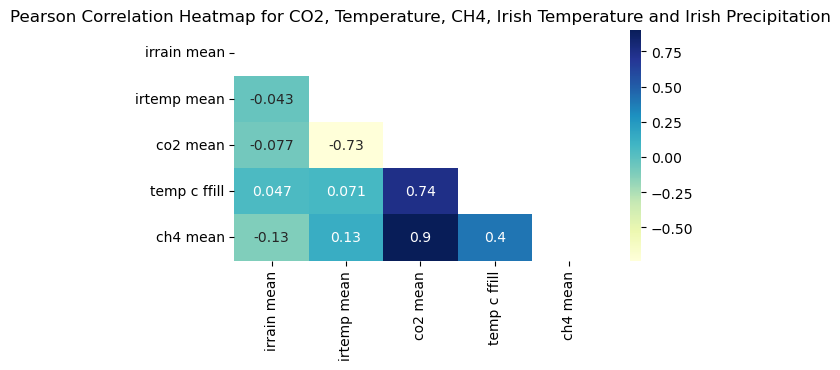

In [111]:
select_dfam = dfampr.loc[:, prcols]

mask = np.triu(np.ones_like(dfampr.corr(method='pearson'))) # create mask for upper triangle

fig, ax = plt.subplots(figsize=(6,3)) 
correplot = sb.heatmap(dfampr.corr(method='pearson'), 
                      cmap="YlGnBu", annot=True, mask=mask)

plt.title('Pearson Correlation Heatmap for CO2, Temperature, CH4, Irish Temperature and Irish Precipitation')
plt.show()

Result shows that CO<sub>2</sub> has a high positive correlation with CH<sub>4</sub> and temperature, and a high negative correlation with Irish temperature.

#### 2.5.2 Trend Analysis

#### 2.5.2.1 Mann-Kendall Test With MK Z Statistic

The Mann-Kendall test with the MK Z statistic is a non-parametric statistical test used to detect trends in time series data (Hussain, Nabi and Boota, 2015, Rajaram, 2021) and quantify changes in the climate system. This test is commonly used in climate change analysis to identify temporal trends in environmental variables, such as temperature, precipitation, or other climate-related parameters (Fathian et al., 2016). Python package pymannkendall was imported and Mann-Kendall test with MK Z statistic was performed according to Hussain Shourov (n.d.) and Hussain and Mahmud (2019).

In [112]:
df_all = pd.read_csv('df_all.csv')

Because there are too many rows in the dataframe, a Period object was created with a yearly frequency (Pandas.pydata.org Period n.d., Pandas.pydata.org Time series, n.d.) in a lambda function (Sharma, 2020, GeeksforGeeks, 2020).

In [113]:
# pd.Period > set index > resample

globalvar = ['co2 mean', 'temp c ffill', 'ch4 mean']

df_all['year reset'] = df_all['year reset'].apply(lambda x: pd.Period(year=x, freq='Y'))
df_all.set_index('year reset', drop=True, inplace=True)

carbon = df_all.resample('1Y')[globalvar[0]].max().dropna()

# carbon.plot(figsize=(15,5))
# plt.title('Time Scale Plot of Atmospheric Carbon Dioxide (ppmv) from 822Kya to 2022'); # file too big for github

In [114]:
mk.original_test(df_all['co2 mean'].dropna(), alpha=0.05)

# OR:

# v_0 = mk.original_test(df[variables[0]].dropna(), alpha=.05)
# v_1 = mk.original_test(df[variables[1]].dropna(), alpha=.05)
# v_2 = mk.original_test(df[variables[2]].dropna(), alpha=.05)
# v_3 = mk.original_test(df[variables[3]].dropna(), alpha=.05)

Mann_Kendall_Test(trend='increasing', h=True, p=0.0, z=25.755981301941972, Tau=0.3068385124207514, s=1507358.0, var_s=3425121973.3333335, slope=0.020304182509505705, intercept=202.10334600760456)

Because the Mann-Kendall test assesses the null hypothesis (H<sub>0</sub>) that there is no trend in the time series data, in CO<sub>2</sub>, H<sub>0</sub> is rejected, and the alternative hypothesis (H<sub>1</sub>) accepted, where there is a monotonic increasing trend in the time series data. 

h=True indicates that the trend is present. 

p (p-value of the significance test) is small (0.0), maybe due to limitations in floating-point representation.

z (Test Statistic (MK Z)) is a normalized test statistics, where a positive Z value indicates an increasing trend, while a negative Z value indicates a decreasing trend (Hussain, Nabi and Boota, 2015). The positive Z value in CO<sub>2</sub> indicates a positive trend.

Tau (Kendall's Tau) is a correlation coefficient that measures the strength and direction of the monotonic relationship between data points, where positive Tau values indicate increasing trends, while negative Tau values indicate decreasing trends (Jain, 2023). The positive Tau value in CO<sub>2</sub> indicates a positive trend.

s (Mann-Kendall's score) represents the sum of the signs of the differences between earlier and later data points (Statistics How To, 2016). 

var_s (Variance of the Mann-Kendall's score (s)) measures the variability of the signs of the differences between earlier and later data points in a time-ordered dataset.

slope (Theil-Sen estimator/slope) provides an estimate of the magnitude of the trend (Higgins, 2023).

intercept (intercept of Kendall-Theil Robust Line) is used to estimate the underlying trend in the time series. The intercept represents the predicted value of the dependent variable when the time index is zero (where the KT-RL line intersects the y-axis) (Granato, 2006).

In [115]:
gtemp = df_all.resample('1Y')[globalvar[1]].max().dropna()

# gtemp.plot(figsize=(15,5))
# plt.title('Time Scale Plot of Global Air Temperature (°C) from 822Kya to 2022'); # file too big for github

In [116]:
mk.original_test(df_all['temp c ffill'].dropna(), alpha=0.05)

Mann_Kendall_Test(trend='increasing', h=True, p=0.0, z=80.74264377530247, Tau=0.39492012399974624, s=67394531.0, var_s=696696079865.0, slope=0.00033916849015317536, intercept=-60.38289934354485)

H<sub>0</sub> (there is no trend in the time series data) is rejected and the alternative hypothesis (H<sub>1</sub>) accepted. The trend is present and increasing. 

Extremely small p-value indicates high significance.

Positive Z value in termperature indicates a positive trend.

Positive Tau value in temperature indicates a positive trend.

In [117]:
methane = df_all.resample('1Y')[globalvar[2]].max().dropna()

# methane.plot(figsize=(15,5))
# plt.title('Time Scale Plot of Atmospheric Methane (ppbv) from 822Kya to 2022'); # file too big for github

In [118]:
mk.original_test(df_all['ch4 mean'].dropna(), alpha=0.05)

Mann_Kendall_Test(trend='increasing', h=True, p=0.0, z=118.77414720783702, Tau=0.898775134994906, s=27092435.0, var_s=52029805970.333336, slope=0.09349251723558097, intercept=492.0620480914747)

H<sub>0</sub> (there is no trend in the time series data) is rejected and the alternative hypothesis (H<sub>1</sub>) accepted. The trend is present and increasing. 

p-value is small (0.0), maybe due to limitations in floating-point representation.

Positive Z value in CH<sub>4</sub> indicates a positive trend.

Positive Tau value in CHO<sub>4</sub> indicates a positive trend.

In [119]:
# For Irish temperature: 

irvar = ['irrain mean', 'irtemp mean']

temp = df_all.resample('1Y')[irvar[-1]].max().dropna() # can try median, min or mean

# temp.plot(figsize=(15,5))
# plt.title('Time Scale Plot of Irish Temperature (°C) from 1831 to 2023'); # file too big for github

In [120]:
mk.original_test(temp, alpha=0.05)

Mann_Kendall_Test(trend='decreasing', h=True, p=7.637224186396452e-12, z=-6.845193986263534, Tau=-0.33149827288428324, s=-6142.0, var_s=804834.6666666666, slope=-0.05060003840245776, intercept=29.032603686635944)

H<sub>0</sub> (there is no trend in the time series data) is rejected and the alternative hypothesis (H<sub>1</sub>) accepted. The trend is present and decreasing. 

Extremely small p-value indicates high significance.

Negative Z value in Irish temperature indicates a negative trend.

Negative Tau value in Irish temperature indicates a negative trend.

In [121]:
# For Irish Precipitation: 

rain = df_all.resample('1Y')[irvar[-2]].mean().dropna() # can try median, min or max

# rain.plot(figsize=(15,5))
# plt.title('Time Scale Plot of Irish Precipitation (mm) from 1711 to 2023'); # file too big for github

In [122]:
mk.original_test(df_all['irrain mean'].dropna(), alpha=0.05)

Mann_Kendall_Test(trend='decreasing', h=True, p=1.1693630508347042e-09, z=-6.084389118384194, Tau=-0.06525830207209156, s=-487800.0, var_s=6427585308.666667, slope=-0.003380903839619437, intercept=89.13528712198436)

H<sub>0</sub> (there is no trend in the time series data) is rejected and the alternative hypothesis (H<sub>1</sub>) accepted. The trend is present and decreasing. 

Extremely small p-value indicates high significance.

Negative Z value in Irish precipitation indicates a negative trend.

Negative Tau value in Irish precipitation indicates a negative trend.

#### 2.5.2.2 Fast Fourier Transform (FFT)

The Fast Fourier Transform (FFT) transforms a time domain function into the frequency domain signal (Bhandari, 2023). It simplifies the Discrete Fourier Transform (DFT) computation and is particularly useful in large datsets (GeeksforGeeks FFT, 2019). In the context of climate change analysis, FFT can be applied to examine climate oscillations, periodic patterns, seasonal variations, diurnal cycles, trends, and frequency-based anomalies (Liu et al., 2024). 

FFT can be used to transform time-domain data into the frequency domain while removing interference and noise to reveal relevant periodic patterns and cycles in the climate data (Quora, 2023). FFT can be useful in studying extreme climate events, such as hurricanes, droughts, or heatwaves (ELmaghraby, Abu Khadra and Eissa, 2016). By analyzing the frequency components of extreme events, researchers can gain insights into the underlying processes and better predict the likelihood and intensity of such events in the future (Quora, 2023). Time frequency analysis allows researchers to track the evolution of climate patterns and identify trends or shifts in the frequency domain (Quora, 2023). Understanding these patterns is crucial for predicting future climate trends and assessing the impact of climate change on various timescales. Analysis of this time series was done according to MacLeod (n.d.), Docs.scipy.org fft (n.d.) and charlesreid1 (2019).

In [123]:
# Note: FFT needs evenly sampled data, so may need to interpolate or resample data

df_fft = df_all[['co2 mean', 'ch4 mean', 'temp c ffill']].ffill()
time = df_fft.index 
time = time.astype(str).astype(float)
df_fft_resampled = df_fft.resample('1000Y')[['co2 mean', 'ch4 mean', 'temp c ffill']].mean()
df_fft_resampled.dropna(how='any', inplace=True)
co2 = df_fft_resampled ['co2 mean']
ch4 = df_fft_resampled ['ch4 mean']
temp = df_fft_resampled ['temp c ffill']

co2_fft = fft(co2.values)
ch4_fft = fft(ch4.values)
temp_fft = fft(temp.values)

n = len(time)
sampling_rate = 1 / (time[1] - time[0])
frequencies = fftfreq(co2.shape[0], d=1/sampling_rate) 

fig = make_subplots(rows=3, cols=1, subplot_titles=("CO2", "CH4", "Temperature"))

fig.append_trace(go.Scatter(
    x=frequencies,
    y=np.abs(co2_fft),
), row=1, col=1)

fig.append_trace(go.Scatter(
    x=frequencies,
    y=np.abs(ch4_fft),
), row=2, col=1)

fig.append_trace(go.Scatter(
    x=frequencies,
    y=np.abs(temp_fft)
), row=3, col=1)

fig.update_xaxes(title_text="Frequency (1/1000Y)", row=1, col=1)
fig.update_xaxes(title_text="Frequency (1/1000Y)", row=2, col=1)
fig.update_xaxes(title_text="Frequency (1/1000Y)", row=3, col=1)

fig.update_yaxes(title_text="Magnitude Of Frequency", row=1, col=1)
fig.update_yaxes(title_text="Magnitude Of Frequency", row=2, col=1)
fig.update_yaxes(title_text="Magnitude Of Frequency", row=3, col=1)

fig.update_layout(height=600, width=400, 
                  title_text="FFT Subplots for Carbon Dioxide, Methane <br> and Air Temperature", showlegend=False)
fig.show()

All parameters were resampled at 1000 years mean. Peaks in the FFT plot indicate dominant frequencies occuring in the data and the magnitude of the frequency is in y-axis.

For CO<sub>2</sub>, CH<sub>4</sub> and temperature, results suggest that there is a significant dominant frequency every 10000 years and a lesser magnitude one every 25000 years.

#### 2.5.2.3 Multi-Seasonal Time Series Decomposition for Ireland's Temperature and Precipitation

Time Series Decomposition helps identify patterns and trends by decomposing a time series into its trend, seasonal, and residual components Palvel (2023). Multi-Seasonal Time Series Decomposition was performed according to Bexgboost (2023) and Manani (2022).

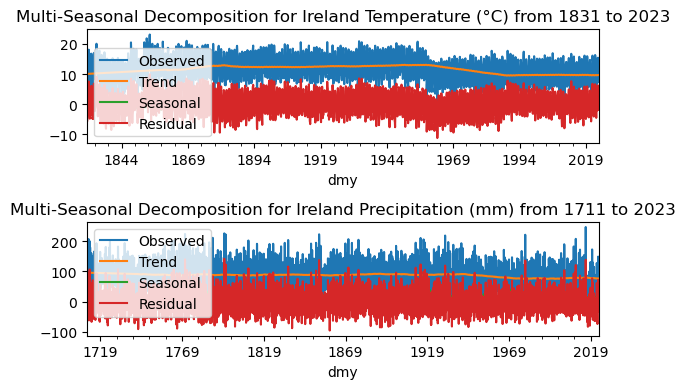

In [124]:
result_temperature = seasonal_decompose(df_irtemp_all.resample('1M')['irtemp mean'].mean().dropna(), 
                                        two_sided=False, extrapolate_trend='freq', period=365)
result_precipitation = seasonal_decompose(df_irrain_all.resample('1M')['irrain mean'].mean().dropna(), 
                                          two_sided=False, extrapolate_trend='freq', period=365)

plt.figure(figsize=(6, 4))

plt.subplot(2, 1, 1)
result_temperature.observed.plot(label='Observed')
result_temperature.trend.plot(label='Trend')
result_temperature.seasonal.plot(label='Seasonal')
result_temperature.resid.plot(label='Residual')
plt.title('Multi-Seasonal Decomposition for Ireland Temperature (°C) from 1831 to 2023')
plt.legend()

plt.subplot(2, 1, 2)
result_precipitation.observed.plot(label='Observed')
result_precipitation.trend.plot(label='Trend')
result_precipitation.seasonal.plot(label='Seasonal')
result_precipitation.resid.plot(label='Residual')
plt.title('Multi-Seasonal Decomposition for Ireland Precipitation (mm) from 1711 to 2023')
plt.legend()

plt.tight_layout()
plt.show()

For Ireland's temperature and precipitation, results are as follows:

Observed Plot: Seasonal effect is present.

Trend Plot: Ireland's temperature and precipitation have remained relatively constant.

Seasonal Plot: Seasonal pattern spikes indicate weaker but consistent seasonality.

Residual Plot: There are no clear systematic patterns or irregularities in the data after removing the trend and seasonal components.

#### 2.5.2.4 Ireland's Temperature Signal to Noise Ratio (SNR)

Ireland's Signal to Noise Ratio (SNR) for annual mean temperature were performed according to Murphy et al. (2023) and (Hawkins et al., 2020). The signal of global temperature change is defined as SNR<1 is normal, 1<SNR<2 is unusual, 2<SNR<3 is unfamiliar and 3<SNR<5 is unknown and SNR>5 is inconceivable when compared against the early‐industrial period of 1850 to 1900 (Hawkins et al., 2020). As described in Hawkins et al. (2017), data was smoothed with a lowess ﬁlter of 41 years (Weckesser, 2015, www.statsmodels.org LOWESS Smoother, n.d., www.statsmodels.org lowess, n.d.). BAr chart was generated according to plotly.com Bar Charts (n.d.), and a break line was introduced in the long plotly title according to Plotly Community Forum (2019).

### **NOTE: Lowess Smoothing cell takes >15 minutes to execute. Output was saved as "df_alin.csv". Skip to df_alin = pd.read_csv('df_alin.csv').**

In [125]:
# df_all = pd.read_csv('df_all.csv')
# df_all.head(3)
# df_alin = df_all[
#                         (df_all['year reset'] >= 821719.08333) &
#                          (df_all['year reset'] <= 821911.9166667)
#                          ][[
#                              'year reset', 
#                              'irtemp mean', 
#                              'anom modern anom'
#                              ]] .copy()
# df_alin

In [126]:
# it, frac = 41, 0.95

# irish_lowess = lowess(endog=df_alin['irtemp mean'], 
#             exog=df_alin.index,
#             it=it,
#             frac=frac
#             )

# # anom modern anom is yearly, so use it=41 like Hawkins et al., (2020)

# global_lowess = lowess(endog=df_alin['anom modern anom'],
#                 exog=df_alin.index,
#                 it=it,
#                 frac=frac
#                 )

# irish_lowess = pd.DataFrame(irish_lowess)
# irish_lowess.columns = ['date', 'irish smoothed']

# global_lowess = pd.DataFrame(global_lowess)
# global_lowess.columns = ['date', 'global smoothed']

In [127]:
# df_alin = df_alin.merge(irish_lowess, 
#                        left_index=True, right_on='date',
#                        how='left')

# df_alin.merge(global_lowess, left_on='date', right_on='date', how='left').to_csv('df_alin.csv', index=True)

In [128]:
df_alin = pd.read_csv('df_alin.csv')
df_alin.set_index('year reset', inplace=True)

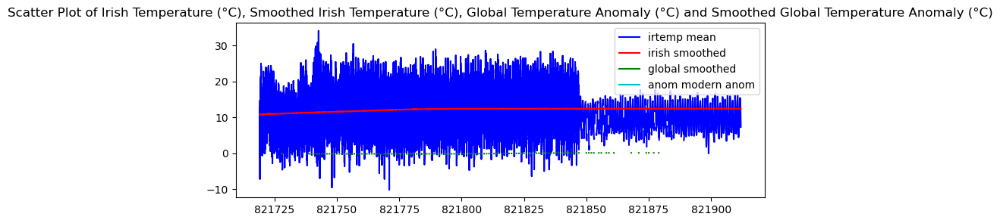

In [129]:
# px.scatter(df_alin, width=600,
#         y=['irtemp mean', 'irish smoothed', 'global smoothed', 'anom modern anom'],
#         title="Scatter Plot of Irish Temperature (°C), Smoothed Irish Temperature (°C), <br> Global Temperature Anomaly (°C) and Smoothed Global Temperature Anomaly (°C)") 

fig,ax = plt.subplots(figsize=(9, 3))
ax.plot(df_alin.index, df_alin['irtemp mean'], label='irtemp mean', c='b')
ax.plot(df_alin.index, df_alin['irish smoothed'], label='irish smoothed', c='r')
ax.plot(df_alin.index, df_alin['global smoothed'], label='global smoothed', c='g')
ax.plot(df_alin.index, df_alin['anom modern anom'], label='anom modern anom', c='c')
ax.legend()
plt.title("Scatter Plot of Irish Temperature (°C), Smoothed Irish Temperature (°C), Global Temperature Anomaly (°C) and Smoothed Global Temperature Anomaly (°C)");

In [130]:
lin_fiti = px.scatter(df_alin,
                    x='global smoothed', y='irish smoothed', 
                    trendline='ols', width=600,
                    title="Scatter Plot of Smoothed Global Anomaly (°C) <br> and Smoothed Ireland Temperature (°C)")
lin_fiti.show()

In [131]:
paramsi = px.get_trendline_results(lin_fiti).iloc[0].values[0] 
alphai, intercepti = paramsi.params[1], paramsi.params[0]

df_alin['irish calculated'] = alphai * df_alin['global smoothed'] + intercepti

print(np.array([alphai, intercepti, paramsi.rsquared]).round(8))

[ 2.00159457 12.40628621  0.28901933]


In [132]:
df_alin['residual'] = ((alphai * df_alin['global smoothed'] + intercepti) - df_alin['irtemp mean'])
df_alin.head(3)

,Unnamed: 0,irtemp mean,anom modern anom,date,irish smoothed,global smoothed,irish calculated,residual
year reset,,,,,,,,
821719.083333,0,NaN,NaN,18582.0,NaN,NaN,NaN,NaN
821719.083333,1,NaN,NaN,18583.0,NaN,NaN,NaN,NaN
821719.083333,2,NaN,NaN,18584.0,NaN,NaN,NaN,NaN


Bar chart was generated according to matplotlib.org bar (n.d.).

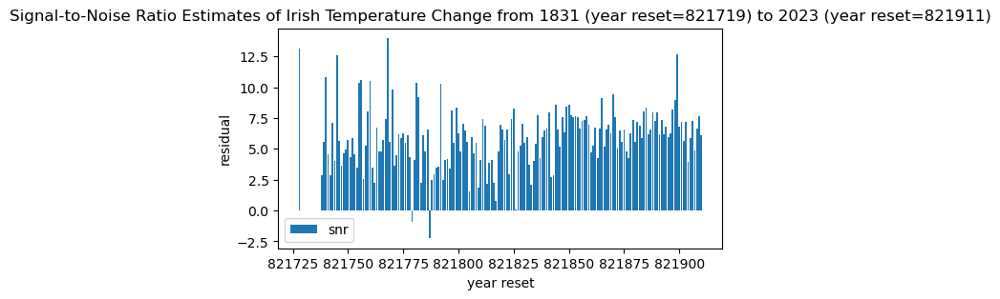

In [133]:
# px.bar(df_alin['residual'].dropna().reset_index().drop_duplicates(subset='year reset'),
#        x='year reset', y='residual', width=600,
#        title= "Signal‐to‐Noise Ratio Estimates of Irish Temperature Change from <br> 1831 (year reset=821719) to 2023 (year reset=821911)")

fig,ax = plt.subplots(figsize=(6, 3))
ax.bar(df_alin['residual'].dropna().reset_index().drop_duplicates(subset='year reset')['year reset'], 
       df_alin['residual'].dropna().reset_index().drop_duplicates(subset='year reset')['residual'], 
       label='snr')
ax.set_xlabel('year reset')
ax.set_ylabel('residual')
ax.legend()
ax.set_title("Signal‐to‐Noise Ratio Estimates of Irish Temperature Change from 1831 (year reset=821719) to 2023 (year reset=821911)");

Result shows that Ireland's temperature SNR at present are mostly categorised as "inconceivable" (SNR>5) when compared to the early‐industrial period of 1850 to 1900.

#### 2.5.3 Temporal Lead/Lag Analysis

#### 2.5.3.1 The Granger Causality Test

The Granger causality test  assesses whether past values of one variable can provide information about future values of another variable, with the conditions that the data should have a constant mean, constant variance and without seasonal component (Padav, 2021). Statsmodels package was installed(www.statsmodels.org, n.d.) and analysis was performed according to Prabhakaran (2022) and Moro (2021) at maxlag=1 (maximum possible time delay) (Package ‘VLTimeCausality’, 2022).

In [134]:
result_co2_temp = grangercausalitytests(df_all[['co2 mean','temp c ffill']].dropna(), maxlag=3)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=8.2763  , p=0.0051  , df_denom=87, df_num=1
ssr based chi2 test:   chi2=8.5617  , p=0.0034  , df=1
likelihood ratio test: chi2=8.1785  , p=0.0042  , df=1
parameter F test:         F=8.2763  , p=0.0051  , df_denom=87, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=3.2125  , p=0.0452  , df_denom=84, df_num=2
ssr based chi2 test:   chi2=6.8075  , p=0.0332  , df=2
likelihood ratio test: chi2=6.5598  , p=0.0376  , df=2
parameter F test:         F=3.2125  , p=0.0452  , df_denom=84, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=1.6938  , p=0.1749  , df_denom=81, df_num=3
ssr based chi2 test:   chi2=5.5206  , p=0.1374  , df=3
likelihood ratio test: chi2=5.3543  , p=0.1476  , df=3
parameter F test:         F=1.6938  , p=0.1749  , df_denom=81, df_num=3


Result shows that a p-value of less than 0.05 indicate a causal relationship between CO<sub>2</sub> and temperature at maxlag=2.

In [135]:
result_co2_methane = grangercausalitytests(df_all[['co2 mean', 'ch4 mean']].dropna(), maxlag=3)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=12.9923 , p=0.0007  , df_denom=48, df_num=1
ssr based chi2 test:   chi2=13.8043 , p=0.0002  , df=1
likelihood ratio test: chi2=12.2169 , p=0.0005  , df=1
parameter F test:         F=12.9923 , p=0.0007  , df_denom=48, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=11.1322 , p=0.0001  , df_denom=45, df_num=2
ssr based chi2 test:   chi2=24.7382 , p=0.0000  , df=2
likelihood ratio test: chi2=20.0984 , p=0.0000  , df=2
parameter F test:         F=11.1322 , p=0.0001  , df_denom=45, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=30.2602 , p=0.0000  , df_denom=42, df_num=3
ssr based chi2 test:   chi2=105.9106, p=0.0000  , df=3
likelihood ratio test: chi2=56.4004 , p=0.0000  , df=3
parameter F test:         F=30.2602 , p=0.0000  , df_denom=42, df_num=3


Result shows that CO<sub>2</sub> correlates with a rise in CH<sub>4</sub> and causality can be infered from it.

In [136]:
result_temp_ch4 = grangercausalitytests(df_all[['temp c ffill', 'ch4 mean']].dropna(), maxlag=3)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=16.4744 , p=0.0001  , df_denom=5183, df_num=1
ssr based chi2 test:   chi2=16.4840 , p=0.0000  , df=1
likelihood ratio test: chi2=16.4578 , p=0.0000  , df=1
parameter F test:         F=16.4744 , p=0.0001  , df_denom=5183, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=23.5034 , p=0.0000  , df_denom=5180, df_num=2
ssr based chi2 test:   chi2=47.0521 , p=0.0000  , df=2
likelihood ratio test: chi2=46.8399 , p=0.0000  , df=2
parameter F test:         F=23.5034 , p=0.0000  , df_denom=5180, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=18.1891 , p=0.0000  , df_denom=5177, df_num=3
ssr based chi2 test:   chi2=54.6411 , p=0.0000  , df=3
likelihood ratio test: chi2=54.3551 , p=0.0000  , df=3
parameter F test:         F=18.1891 , p=0.0000  , df_denom=5177, df_num=3


Result shows that a p-value of less than 0.05 indicates a causal relationship between temperature and CH<sub>4</sub>.

#### 2.5.3.2 Autocorrelation Function (ACF) and Partial Autocorrelation Function (PACF)

Autocorrelation and Partial Autocorrelation functions analyse a variable's correlation with itself at different lags in a time series, where high correlation indicates that current values are influenced by its past values (Frost, 2021). The ACF plot is a bar chart of the coefficients of correlation between a time series and its lags (Duke.edu, 2019). The PACF values at certain lags in the plot helps identify the order of the autoregressive (AR) model (online.stat.psu.edu, n.d.). The analyses were performed according to Brownlee (2017) and Mallick (2020). Both the Pandas (Pandas.pydata.org autocorrelation_plot , n.d.) and Statsmodels versions (www.statsmodels.org tsaplots.plot_acf , n.d., www.statsmodels.org tsaplots.plot_pacf, n.d.) were used, with a difference in subtraction of the mean and normalization or division of variance in correlation coefficient determination (Nikhase, 2017).

In [137]:
df_all.index

PeriodIndex([     '0',    '999',   '1069',   '1999',   '2138',   '2999',
               '3207',   '3999',   '4276',   '4999',
             ...
             '821911', '821911', '821911', '821911', '821911', '821911',
             '821911', '821911', '821911', '821999'],
            dtype='period[A-DEC]', name='year reset', length=68989)

In [138]:
# resample to 1000 years to quantify time lag

df_all.resample('1000Y')['co2 mean'].mean().dropna()
df_all.resample('1000Y')['ch4 mean'].mean().dropna()
resampledtll = df_all.resample(
    '1000Y')['temp c ffill'].mean().to_frame(name='temp restll')

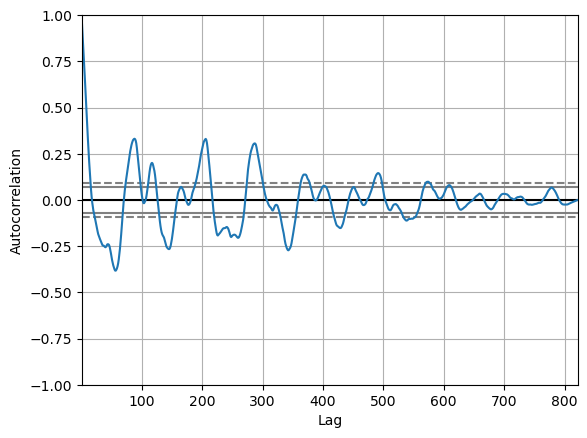

<Figure size 300x200 with 0 Axes>

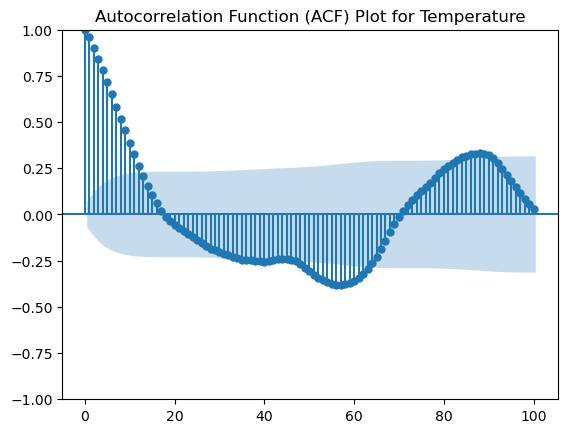

<Figure size 300x200 with 0 Axes>

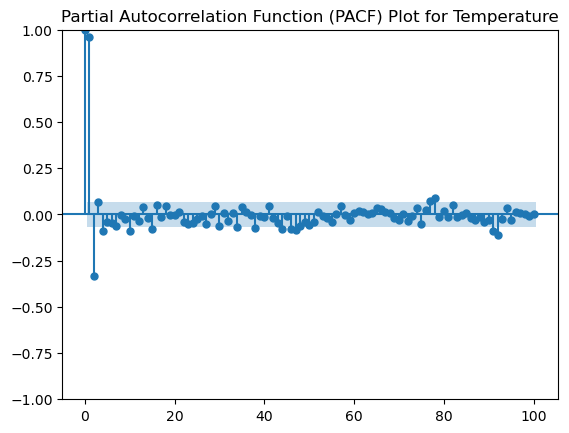

In [139]:
pd.plotting.autocorrelation_plot(resampledtll.dropna());

plt.figure(figsize=(3, 2))
plot_acf(resampledtll.dropna(), lags=100, title='Autocorrelation Function (ACF) Plot for Temperature')
plt.show()

plt.figure(figsize=(3, 2))
plot_pacf(resampledtll.dropna(), lags=100, title='Partial Autocorrelation Function (PACF) Plot for Temperature')
plt.show();

Results show that the ACF values for temperature are statistically significant for lags up to 12000 years, suggesting a meaningful autocorrelation.

The PACF values for temperature are statistically significant at lags 1000 years (positive correlation) and 2000 years (negative correlation), indicating a direct relationship between the ACF value and the lags.

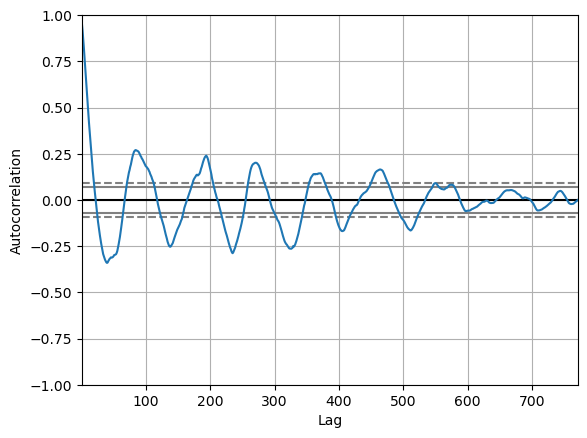

<Figure size 400x300 with 0 Axes>

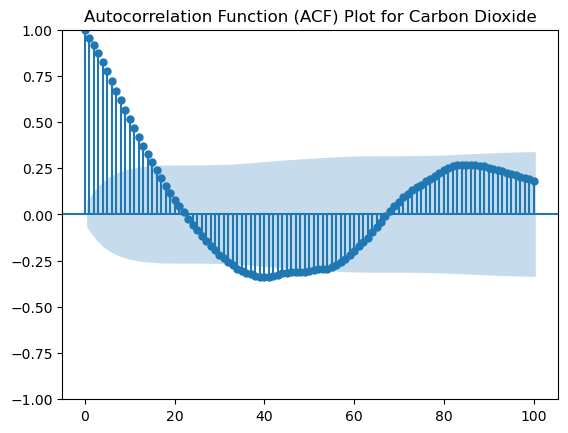

<Figure size 400x300 with 0 Axes>

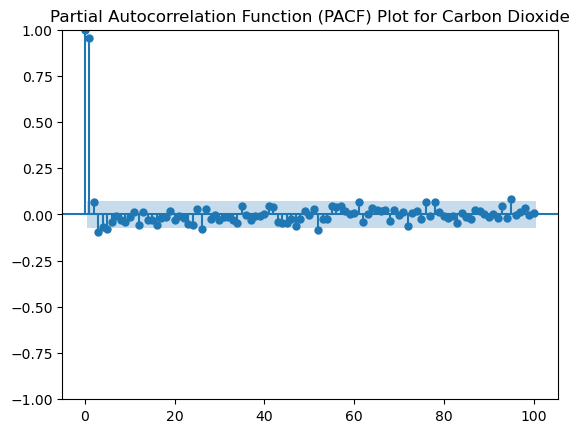

In [140]:
pd.plotting.autocorrelation_plot(df_all.resample('1000Y')['co2 mean'].mean().dropna());

plt.figure(figsize=(4, 3))
plot_acf(df_all.resample('1000Y')['co2 mean'].mean().dropna(), lags=100, title='Autocorrelation Function (ACF) Plot for Carbon Dioxide')
plt.show()

plt.figure(figsize=(4, 3))
plot_pacf(df_all.resample('1000Y')['co2 mean'].mean().dropna(), lags=100, title='Partial Autocorrelation Function (PACF) Plot for Carbon Dioxide')
plt.show();

Results show that the ACF values for CO<sub>2</sub> are statistically significant for lags up to 15000 years, suggesting a meaningful autocorrelation.

The PACF values for CO<sub>2</sub> are statistically significant until lag=1000 years, indicating a direct relationship between the ACF value and the lag.

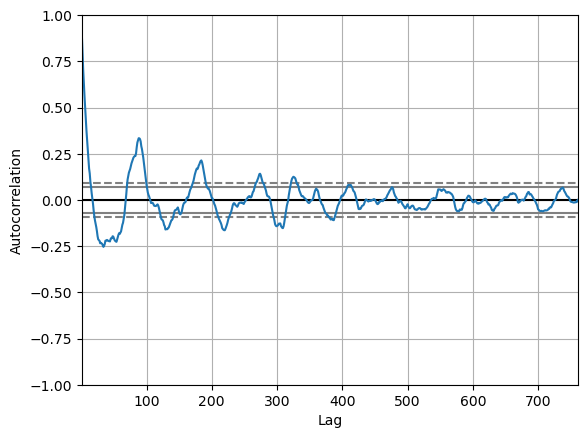

<Figure size 400x300 with 0 Axes>

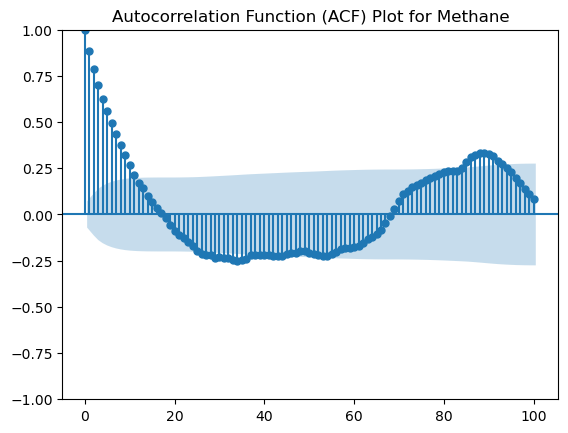

<Figure size 400x300 with 0 Axes>

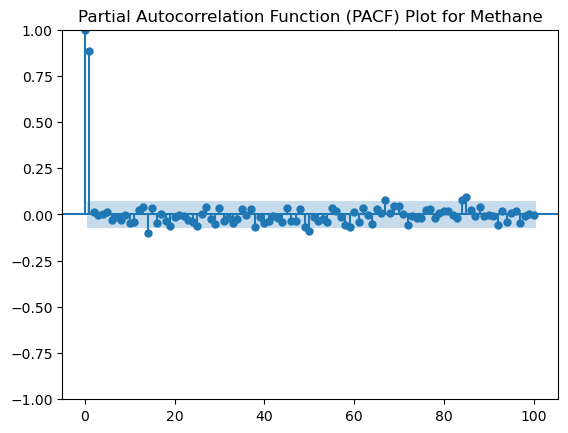

In [141]:
pd.plotting.autocorrelation_plot(df_all.resample('1000Y')['ch4 mean'].mean().dropna());

plt.figure(figsize=(4, 3))
plot_acf(df_all.resample('1000Y')['ch4 mean'].mean().dropna(), lags=100, title='Autocorrelation Function (ACF) Plot for Methane')
plt.show()

plt.figure(figsize=(4, 3))
plot_pacf(df_all.resample('1000Y')['ch4 mean'].mean().dropna(), lags=100, title='Partial Autocorrelation Function (PACF) Plot for Methane')
plt.show();

Results show that the ACF values for CH<sub>4</sub> are statistically significant for lags up to 11000 years, suggesting a meaningful autocorrelation.

The PACF values for CH<sub>4</sub> are statistically significant at 1000 years lag, indicating a direct relationship between the ACF value and the lag.

Because the Irish data has seasonality, it was first detrended using seasonal_decompose (www.statsmodels.org seasonal_decom, n.d.).

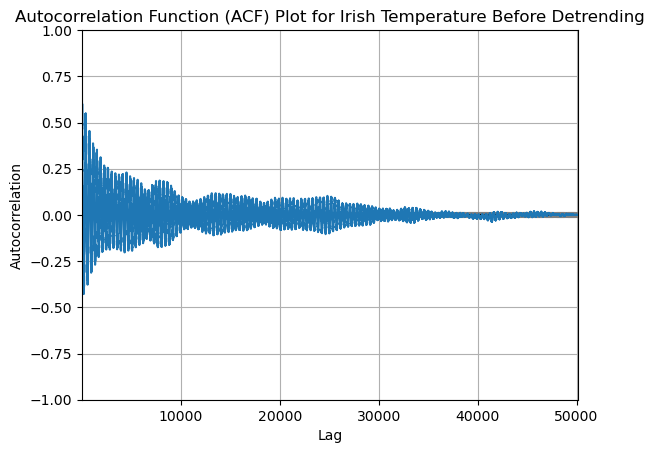

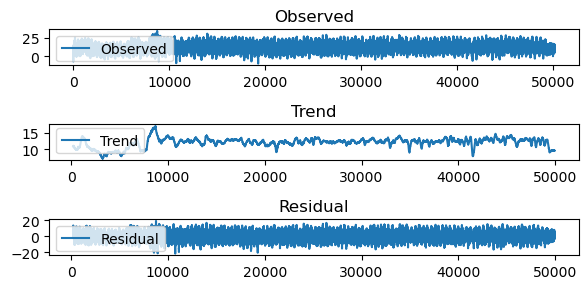

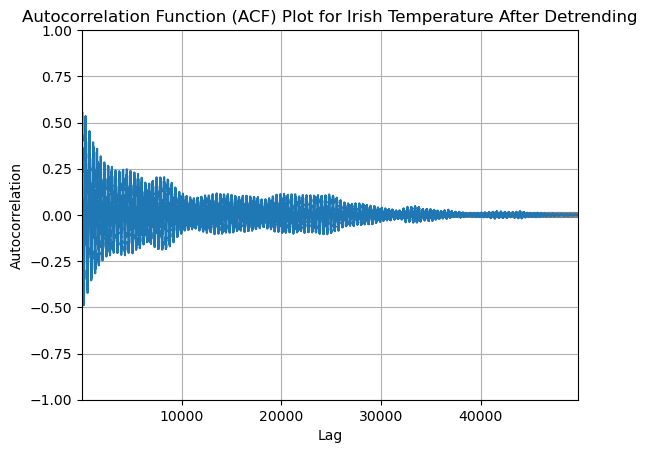

<Figure size 400x300 with 0 Axes>

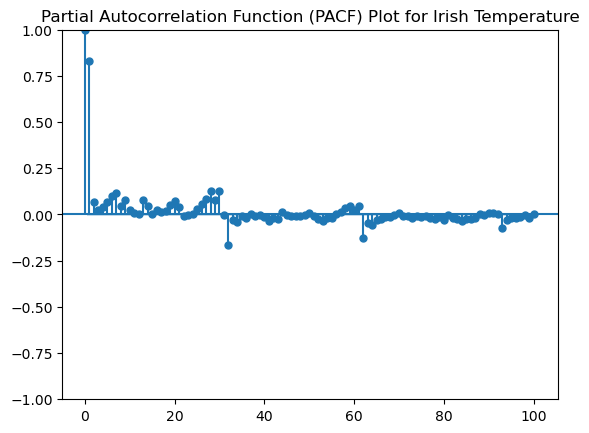

In [142]:
# Irish data:

# autocorrelation BEFORE detrending
pd.plotting.autocorrelation_plot(df_all['irtemp mean'].dropna())
#pd.plotting.autocorrelation_plot(df['irtemp mean'].dropna().iloc[:1000]); # first 1000 rows
plt.title('Autocorrelation Function (ACF) Plot for Irish Temperature Before Detrending')
plt.show()
resultit = seasonal_decompose(df_all['irtemp mean'].dropna(), period=365)

plt.figure(figsize=(6, 3))

plt.subplot(3, 1, 1)
plt.plot(resultit.observed.values, label='Observed')
plt.legend()
plt.title('Observed')

plt.subplot(3, 1, 2)
plt.plot(resultit.trend.values, label='Trend')
plt.legend()
plt.title('Trend')

plt.subplot(3, 1, 3)
plt.plot(resultit.resid.values, label='Residual')
plt.legend()
plt.title('Residual')

plt.tight_layout()
plt.show()

# autocorrelation AFTER detrending
pd.plotting.autocorrelation_plot(resultit.resid.dropna())
plt.title('Autocorrelation Function (ACF) Plot for Irish Temperature After Detrending')
plt.show()


# Plot PACF for Irish Temperature
plt.figure(figsize=(4, 3))
plot_pacf(resultit.resid.dropna(), lags=100, title='Partial Autocorrelation Function (PACF) Plot for Irish Temperature')
plt.show();

The result shows that the correlation between Irish temperature and its lagged version decreases over time. The observed and trend plots show no long term trend. The residual plot exhibit no clear patterns  in temperature variations after removing the trend and seasonal components.

The PACF plot at lag 1 suggests a strong relationship between the current observation and its immediate preceding observation.

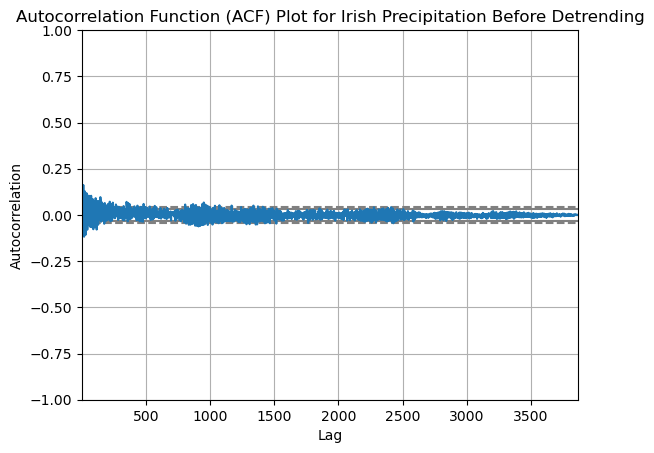

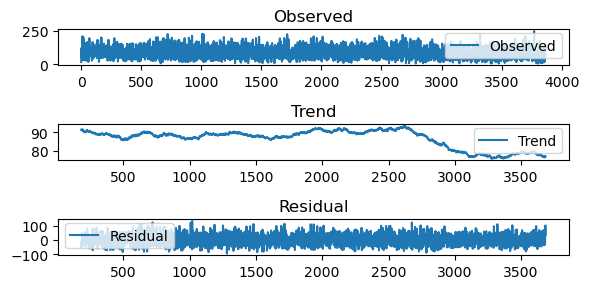

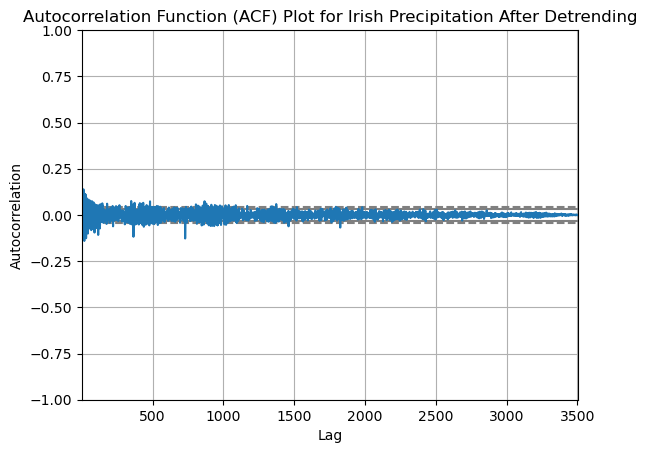

<Figure size 400x300 with 0 Axes>

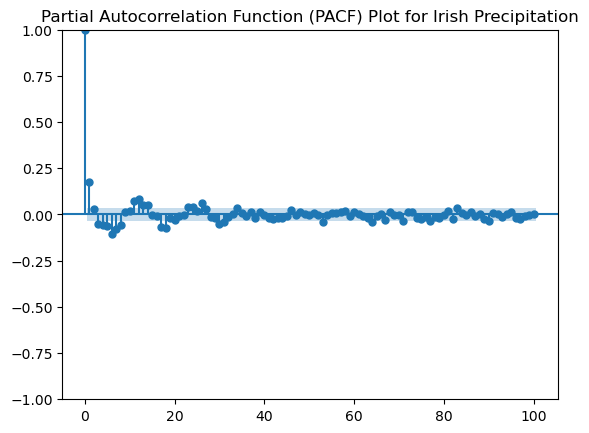

In [143]:
# df_irrain_all.resample('1M')['irrain mean'].mean()
# df['irrain mean']

# autocorrelation BEFORE detrending
pd.plotting.autocorrelation_plot(df_all['irrain mean'].dropna())
#pd.plotting.autocorrelation_plot(df['irrain mean'].dropna().iloc[:1000])
plt.title('Autocorrelation Function (ACF) Plot for Irish Precipitation Before Detrending')
plt.show()

resultir = seasonal_decompose(df_all['irrain mean'].dropna(), period=365)

plt.figure(figsize=(6, 3))

plt.subplot(3, 1, 1)
plt.plot(resultir.observed.values, label='Observed')
plt.legend()
plt.title('Observed')

plt.subplot(3, 1, 2)
plt.plot(resultir.trend.values, label='Trend')
plt.legend()
plt.title('Trend')

plt.subplot(3, 1, 3)
plt.plot(resultir.resid.values, label='Residual')
plt.legend()
plt.title('Residual')

plt.tight_layout()
plt.show()

# autocorrelation AFTER detrending
pd.plotting.autocorrelation_plot(resultir.resid.dropna())
#pd.plotting.autocorrelation_plot(df['irrain mean'].dropna().iloc[:1000])
plt.title('Autocorrelation Function (ACF) Plot for Irish Precipitation After Detrending')
plt.show()

# Plot PACF for Irish Precipitation
plt.figure(figsize=(4, 3))
plot_pacf(resultir.resid.dropna(), lags=100, 
          title='Partial Autocorrelation Function (PACF) Plot for Irish Precipitation')
plt.show()


The result shows no correlation between Irish precipitation and its lagged version. The observed plot shows no long term trend. The trend plots shows a decreasing trend over time. The residual plot exhibits no clear patterns  in precipitation variations after removing the trend and seasonal components.

The PACF plot at lag 1 suggests a weak relationship between the current observation and its immediate preceding observation.

#### 2.5.3.1 Time Lagged Cross-Correlation Analysis

Cross-Correlation Analysis helps identify if changes in one variable lead or lag changes in another by measuring the similarity between two time series when a time lag function is applied to one of them (FasterCapital, n.d.). Positive lags indicate that the second time series follows the first, while negative lags indicate the second time series leads the first (methods-sagepub-com-christuniversity.knimbus.com, 2016). Scipy Python package was installed (projects.scipy.org, n.d.) and Time Lagged Cross-Correlation was executed as shown in docs.scipy.org signal.correlate (n.d.).

In [144]:
co2_series = df_all.resample('1000Y')['co2 mean'].mean().dropna()
temp_series = df_all.resample('1000Y')['temp c ffill'].mean().dropna()

min_length = min(len(co2_series), len(temp_series)) # both time series must have the same length
co2_series = co2_series[:min_length]
temp_series = temp_series[:min_length]

co2_temp = pd.DataFrame([co2_series.values, temp_series.values]).T
co2_temp.index=temp_series.index
co2_temp.shape

(771, 2)

In [145]:
co2_temp.index = co2_temp.index.astype(str).astype(float)
# px.scatter(co2_temp, title="Scatter Plot of Carbon Dioxide (ppmv) and Air Temperature (°C) from 822kya to 2022")
# file too big for github

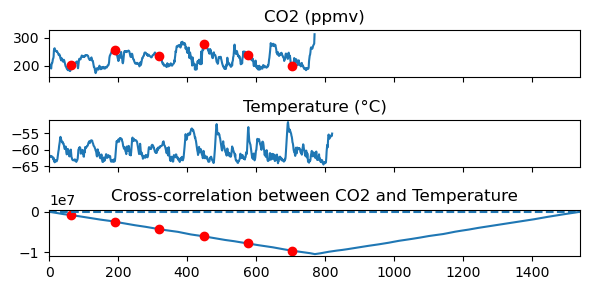

In [146]:
corr = correlate(co2_series, temp_series, 
                 method='direct'
                 )

sig = df_all.resample('1000Y')['co2 mean'].mean().dropna().values
sig_noise = df_all.resample('1000Y')['temp c ffill'].mean().dropna().values
sig.shape, sig_noise.shape

clock = np.arange(64, len(sig), 128)

fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True, figsize=(6,3))
ax_orig.plot(sig)
ax_orig.plot(clock, sig[clock], 'ro')
ax_orig.set_title('CO2 (ppmv)')

ax_noise.plot(sig_noise)
ax_noise.set_title('Temperature (°C)')

ax_corr.plot(corr)
ax_corr.plot(clock, corr[clock], 'ro')
ax_corr.axhline(y=0.5, ls='--')
ax_corr.set_title('Cross-correlation between CO2 and Temperature')

ax_orig.margins(0, 0.1)
fig.tight_layout()
plt.show()

Result shows that CO<sub>2</sub> and temperature exhibit negative cross-correlation towards present time, suggesting that temperature increase is followed by CO<sub>2</sub> increase.

In [147]:
co2_series = df_all.resample('1000Y')['co2 mean'].mean().dropna()
ch4_series = df_all.resample('1000Y')['ch4 mean'].mean().dropna()

min_length = min(len(co2_series), len(ch4_series)) # both time series must have the same length
co2_series = co2_series[:min_length]
ch4_series = ch4_series[:min_length]

co2_ch4 = pd.DataFrame([co2_series.values, ch4_series.values]).T
co2_ch4.index=ch4_series.index
co2_ch4.shape

(761, 2)

In [148]:
co2_ch4.index = co2_ch4.index.astype(str).astype(float)
# px.scatter(co2_ch4, title="Scatter Plot of Carbon Dioxide (ppmv) and Methane (ppbv) from 822kya to 2022")
# file too big for github

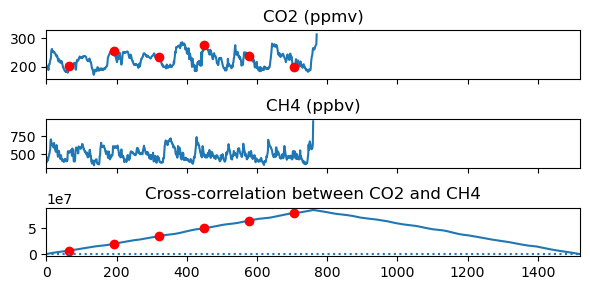

In [149]:
corr = correlate(co2_series, ch4_series, 
                 method='direct'
                 )

sig = df_all.resample('1000Y')['co2 mean'].mean().dropna().values
sig_noise = df_all.resample('1000Y')['ch4 mean'].mean().dropna().values
sig.shape, sig_noise.shape

clock = np.arange(64, len(sig), 128)

fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True, figsize=(6,3))
ax_orig.plot(sig)
ax_orig.plot(clock, sig[clock], 'ro')
ax_orig.set_title('CO2 (ppmv)')

ax_noise.plot(sig_noise)
ax_noise.set_title('CH4 (ppbv)')

ax_corr.plot(corr)
ax_corr.plot(clock, corr[clock], 'ro')
ax_corr.axhline(0.5, ls=':')
ax_corr.set_title('Cross-correlation between CO2 and CH4')

ax_orig.margins(0, 0.1)
fig.tight_layout()
plt.show()

Result shows that CO<sub>2</sub> and CH<sub>4</sub> exhibit stronger positive cross-correlation towards present time, suggesting that CO<sub>2</sub> increase is followed by CH<sub>4</sub> increase.

In [150]:
temp_series = df_all.resample('1000Y')['temp c ffill'].mean().dropna()
ch4_series = df_all.resample('1000Y')['ch4 mean'].mean().dropna()

min_length = min(len(temp_series), len(ch4_series)) # both time series must have the same length
temp_series = temp_series[:min_length]
ch4_series = ch4_series[:min_length]

temp_ch4 = pd.DataFrame([temp_series.values, ch4_series.values]).T
temp_ch4.index=ch4_series.index
temp_ch4.shape

(761, 2)

In [151]:
temp_ch4.index = temp_ch4.index.astype(str).astype(float)
# px.scatter(temp_ch4, title="Scatter Plot of Atmospheric Temperature (°C) and Methane (ppbv) from 822kya to 2022")
# file too big for github

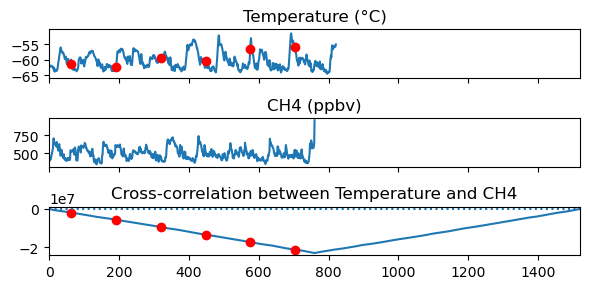

In [152]:
corr = correlate(temp_series, ch4_series, 
                 method='direct'
                 )

sig = df_all.resample('1000Y')['temp c ffill'].mean().dropna().values
sig_noise = df_all.resample('1000Y')['ch4 mean'].mean().dropna().values
sig.shape, sig_noise.shape

clock = np.arange(64, len(sig), 128)

fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True, figsize=(6,3))
ax_orig.plot(sig)
ax_orig.plot(clock, sig[clock], 'ro')
ax_orig.set_title('Temperature (°C)')

ax_noise.plot(sig_noise)
ax_noise.set_title('CH4 (ppbv)')

ax_corr.plot(corr)
ax_corr.plot(clock, corr[clock], 'ro')
ax_corr.axhline(0.5, ls=':')
ax_corr.set_title('Cross-correlation between Temperature and CH4')

ax_orig.margins(0, 0.1)
fig.tight_layout()
plt.show()

Result shows that temperature and CH<sub>4</sub> exhibit negative cross-correlation towards present time, suggesting that CH<sub>4</sub> increase is followed by temperature increase.

In [153]:
irtemp_series = df_irtemp_all.resample('1Y')['irtemp mean'].mean()
irrain_series = df_irrain_all.resample('1Y')['irrain mean'].mean()

min_length = min(len(irtemp_series), len(irrain_series)) # both time series must have the same length
irtemp_series = irtemp_series[:min_length]
irrain_series = irrain_series[:min_length]

irtemp_irrain = pd.DataFrame([irtemp_series.values, irrain_series.values]).T
irtemp_irrain.index=irrain_series.index
irtemp_irrain.shape

(193, 2)

In [154]:
df_irtemp_all.index = df_irtemp_all.index.values.astype(float)
df_irrain_all.index = df_irrain_all.index.values.astype(float)

# px.scatter(irtemp_irrain, title="Scatter Plot of Irish Precipitation (mm) (1711-2023) and Temperature (°C) (1831-2023)")

# file too big for github

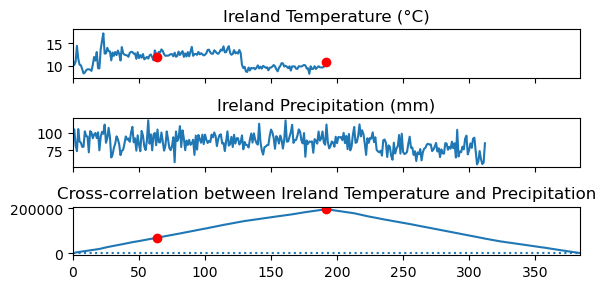

In [155]:
df_irtemp_all.index = pd.to_datetime(df_irtemp_all.index)
df_irrain_all.index = pd.to_datetime(df_irrain_all.index)

corr = correlate(irtemp_series, irrain_series, 
                 method='direct'
                 )

sig = df_irtemp_all.resample('1Y')['irtemp mean'].mean().dropna().values
sig_noise = df_irrain_all.resample('1Y')['irrain mean'].mean().dropna().values
sig.shape, sig_noise.shape

clock = np.arange(64, len(sig), 128)

fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True, figsize=(6,3))
ax_orig.plot(sig)
ax_orig.plot(clock, sig[clock], 'ro')
ax_orig.set_title('Ireland Temperature (°C)')

ax_noise.plot(sig_noise)
ax_noise.set_title('Ireland Precipitation (mm)')

ax_corr.plot(corr)
ax_corr.plot(clock, corr[clock], 'ro')
ax_corr.axhline(0.5, ls=':')
ax_corr.set_title('Cross-correlation between Ireland Temperature and Precipitation')

ax_orig.margins(0, 0.1)
fig.tight_layout()
plt.show()

Result shows that there is positive cross-correlation between Ireland's temperature and precipitation towards present time, suggesting that temperature increase is followed by precipitation increase.

#### 2.5.4 Global Temperature Anomaly Prediction

Prediction of global temperature anomaly over next few decades was performed using linear regression as shown by Das (2019) and Mali (2021).

In [156]:
df_all = pd.read_csv('df_all.csv')

In [157]:
df_all_plot = df_all[['year reset', 'anom modern anom', 'temp c ffill', 'co2 mean']].ffill().copy()
df_all_plot.dropna(inplace=True)

In [158]:
df_all['temp cffill mod'] = df_all[['temp c ffill', 'modern temp c']].mean(1)
df_all['anom c mod'] = df_all[['anom c', 'modern anom c']].mean(1)
df_all[['year reset', 'temp cffill mod', 'anom c mod', 'co2 mean']].to_csv('df_all_plot.csv', index=False)

In [159]:
df_all_plot = pd.read_csv('df_all_plot.csv') 

In [160]:
df_all_plot.ffill().dropna(inplace=True)

In [161]:
# px.scatter(df_all_plot, x='year reset', 
#            y=df_all_plot.drop(columns='year reset').columns, trendline='ols',
#            title = 'Global Atmospheric Temperature (°C), Temperature Anomaly (°C) and Carbon Dioxide (ppmv) from 822Kya to 2022'
#            )  # file too big for github

Mean Squared Error: 11.83548868726762


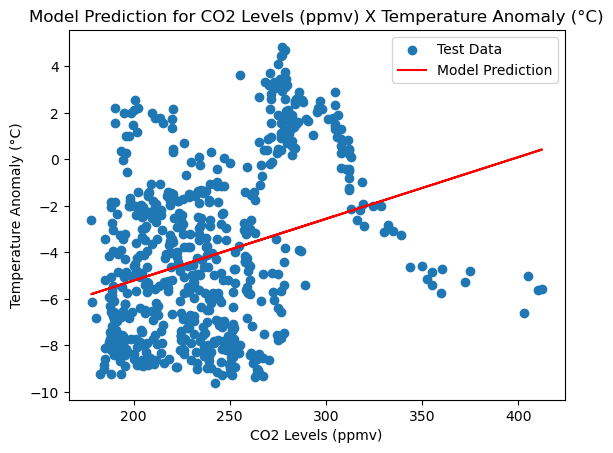

In [162]:
history = df_all_plot[df_all_plot['year reset'] <= 2022]

X = df_all_plot[['co2 mean']].dropna()
y = df_all_plot[['anom c mod']].dropna()

min_length = min(len(X), len(y)) # both time series must have the same length
X = X[:min_length]
y = y[:min_length]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

model = LinearRegression()
model.fit(X_train, y_train)

predictions = model.predict(X_test)

mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')

# print('Score :' ,model.score(X_test,y_test))

plt.scatter(X_test, y_test, label='Test Data')
plt.plot(X_test, predictions, label='Model Prediction', color='red')
plt.title("Model Prediction for CO2 Levels (ppmv) X Temperature Anomaly (°C)")
plt.xlabel('CO2 Levels (ppmv)')
plt.ylabel('Temperature Anomaly (°C)')
plt.legend()
plt.show();

In [163]:
# Using the trained model to extrapolate temperature anomalies for future years

future_years = np.arange(2023, 3000).reshape(-1, 1)
future_co2 = model.predict(future_years)

X = np.concatenate([history['year reset'], future_years.reshape(-1) ])
y = np.concatenate([history['anom c mod'], future_co2.reshape(-1)])

Xy = pd.DataFrame([X, y]).T
Xy.columns = ['year reset', 'Temperature Anomaly x CO2 Levels']

Xy

,year reset,Temperature Anomaly x CO2 Levels
0,0.0,NaN
1,999.0,NaN
2,1069.0,NaN
3,1999.0,NaN
4,2023.0,43.162198
...,...,...
976,2995.0,68.952122
977,2996.0,68.978654
978,2997.0,69.005187
979,2998.0,69.031720


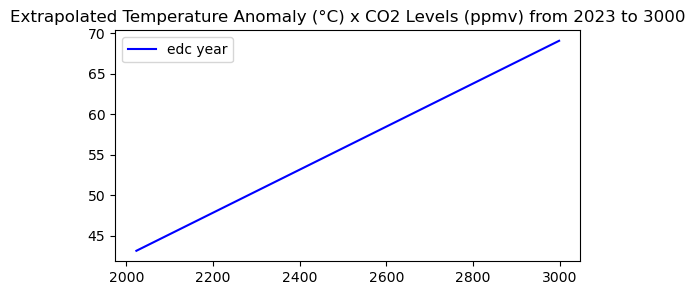

In [164]:
# px.scatter(Xy, x='year reset', y='Temperature Anomaly x CO2 Levels', width=600, 
#            title="Extrapolated Temperature Anomaly (°C) x CO2 Levels (ppmv) from 2023 to 3000"
#            )

fig,ax = plt.subplots(figsize=(6, 3))
ax.plot(Xy['year reset'], Xy['Temperature Anomaly x CO2 Levels'], label='edc year', c='b')
ax.legend()
ax.set_title("Extrapolated Temperature Anomaly (°C) x CO2 Levels (ppmv) from 2023 to 3000");

Result shows that global temperature anomaly will increase over time if atmospheric CO<sub>2</sub> trend keeps increasing as published by Szulejko et al. (2017), Ekwurzel et al. (2017) and NOAA (2023). However, in the ancient climate, Davis (2017) showed that atmospheric CO<sub>2</sub> changes did not cause temperature variations.

Method 2 for global temperature anomaly prediction utilises Ordinary Least Squares (OLS) regression trendline slopes (plotly.com linear-fits, n.d.).

In [165]:
# Method 2:

df_all_plot=pd.read_csv('df_all_plot.csv')

In [166]:
# Check CO2 trend first:

carbon = df_all_plot[['year reset', 'co2 mean']].ffill().dropna()
carbon_ols = px.scatter(carbon, x='year reset', y='co2 mean', trendline='ols', trendline_color_override="red", width=600,
                        title="Carbon Dioxide Levels (ppmv) from 822kya to 2022") 
carbon_ols.show()

In [167]:
carbon_ols_fit = px.get_trendline_results(carbon_ols).iloc[0].values[0]
slopec, interceptc = carbon_ols_fit.params[1], carbon_ols_fit.params[0]
slopec, interceptc

(0.00013144774066754995, 180.24619778483563)

In [168]:
carbon_ols_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.343
Model:                            OLS   Adj. R-squared:                  0.343
Method:                 Least Squares   F-statistic:                 3.597e+04
Date:                Mon, 08 Jan 2024   Prob (F-statistic):               0.00
Time:                        22:37:39   Log-Likelihood:            -3.2623e+05
No. Observations:               68957   AIC:                         6.525e+05
Df Residuals:                   68955   BIC:                         6.525e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        180.2462      0.540    333.863      0.000     179.188     181.304
x1             0.0001   6.93e-07    189.647      0.000       0.000       0.000
==============================================================================
Omnibus:                    16105.837   Durbin-Watson:                   0.003
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            49554.060
Skew:                          -1.203   Prob(JB):                         0.00
Kurtosis:                       6.385   Cond. No.                     4.02e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.02e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [169]:
years = np.array([821988, 822388, 822888]) # Year: 2100, 2500, 3000
carbon_predict = slopec * years + interceptc
carbon_predict

array([288.29466324, 288.34724234, 288.41296621])

In [170]:
carbon_predict = pd.DataFrame([years, carbon_predict]).T
carbon_predict.columns = carbon.columns
carbon_predict['label'] = 'predicted'
carbon['label'] = 'observed'
carbon_predict = pd.concat([carbon, carbon_predict])
carbon_predict

,year reset,co2 mean,label
32,16169.130000,207.290000,observed
33,16705.560000,202.230000,observed
34,16999.000000,202.230000,observed
35,17104.000000,202.230000,observed
36,17315.330000,204.860000,observed
...,...,...,...
68987,821911.916667,417.070000,observed
68988,821999.000000,417.070000,observed
0,821988.000000,288.294663,predicted
1,822388.000000,288.347242,predicted


In [171]:
px.scatter(carbon_predict, x='year reset', y='co2 mean', color='label', trendline='ols',width=600,
           title="Extrapolated Carbon Dioxide Levels (ppmv) from 2023 to 3000")

Result shows that atmospheric CO<sub>2</sub> increases linearly over time, thus matching the trend reported by Szulejko et al. (2017), Ekwurzel et al. (2017) and NOAA (2023). Kang and Larsson (2013) reported a feedback system where temperature and CO<sub>2</sub> Granger-cause each other in both directions.

In [172]:
# Then, check anomaly trend:

anomcm = df_all_plot[['year reset', 'anom c mod']].ffill().dropna()

anomcm_ols = px.scatter(anomcm, x='year reset', y='anom c mod', trendline='ols', trendline_color_override="red", width=600,
                        title="Temperature Anomaly (°C) from 822kya to 2022") 
anomcm_ols.show()

In [173]:
anomcm_ols_fit = px.get_trendline_results(anomcm_ols).iloc[0].values[0]
slopea, intercepta = anomcm_ols_fit.params[1], anomcm_ols_fit.params[0]
slopea, intercepta

(8.803996840327045e-06, -7.937200204619677)

In [174]:
anomcm_ols_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.258
Model:                            OLS   Adj. R-squared:                  0.258
Method:                 Least Squares   F-statistic:                 2.395e+04
Date:                Mon, 08 Jan 2024   Prob (F-statistic):               0.00
Time:                        22:37:40   Log-Likelihood:            -1.5362e+05
No. Observations:               68943   AIC:                         3.072e+05
Df Residuals:                   68941   BIC:                         3.073e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -7.9372      0.044   -179.122      0.000      -8.024      -7.850
x1          8.804e-06   5.69e-08    154.774      0.000    8.69e-06    8.92e-06
==============================================================================
Omnibus:                    24171.676   Durbin-Watson:                   0.009
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            88082.985
Skew:                          -1.761   Prob(JB):                         0.00
Kurtosis:                       7.273   Cond. No.                     4.03e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.03e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [175]:
years = np.array([821988, 822388, 822888]) # Year: 2100, 2500, 3000
anomcm_predict = slopea * years + intercepta
anomcm_predict

array([-0.70042045, -0.69689885, -0.69249685])

In [176]:
anomcm_predict = pd.DataFrame([years, anomcm_predict]).T
anomcm_predict.columns = anomcm.columns
anomcm_predict['label'] = 'predicted'
anomcm['label'] = 'observed'
anomcm_predict = pd.concat([anomcm, anomcm_predict])
anomcm_predict

,year reset,anom c mod,label
46,20176.000000,-8.820000,observed
47,20250.000000,-8.820000,observed
48,20601.940000,-8.820000,observed
49,20999.000000,-8.820000,observed
50,21249.000000,-8.920000,observed
...,...,...,...
68987,821911.916667,0.930000,observed
68988,821999.000000,0.930000,observed
0,821988.000000,-0.700420,predicted
1,822388.000000,-0.696899,predicted


In [177]:
px.scatter(anomcm_predict, x='year reset', y='anom c mod', color='label', trendline='ols', width=600,
           title="Extrapolated Temperature Anomaly (°C) from 2023 to 3000")

In [178]:
# anomaly x CO2

df_all_plot['anomxco2'] = df_all_plot['anom c mod'] * df_all_plot['co2 mean']

In [179]:
anom = df_all_plot[['year reset', 'anomxco2']].dropna()
anom_ols = px.scatter(anom, x='year reset', y='anomxco2', trendline='ols', trendline_color_override="red", width=600,
                      title="Temperature Anomaly (°C) x CO2 Levels (ppmv) from 800kya to 2022") 
anom_ols.show()

# plt.scatter(anom['year reset'], anom['anomxco2'], color='blue', s=10)
# slope, intercept = np.polyfit(anom['year reset'], anom['anomxco2'], 1)
# plt.plot(anom['year reset'], slopex*anom['year reset'] + interceptx, color='red')
# plt.show()

In [180]:
anom_ols_fit = px.get_trendline_results(anom_ols).iloc[0].values[0]
slopex, interceptx = anom_ols_fit.params[1], anom_ols_fit.params[0]
slopex, interceptx

(0.0028054007637301607, -2244.327820299616)

In [181]:
anom_ols_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.279
Model:                            OLS   Adj. R-squared:                  0.268
Method:                 Least Squares   F-statistic:                     25.93
Date:                Mon, 08 Jan 2024   Prob (F-statistic):           3.09e-06
Time:                        22:37:42   Log-Likelihood:                -520.98
No. Observations:                  69   AIC:                             1046.
Df Residuals:                      67   BIC:                             1050.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2244.3278    441.521     -5.083      0.000   -3125.607   -1363.049
x1             0.0028      0.001      5.092      0.000       0.002       0.004
==============================================================================
Omnibus:                       42.822   Durbin-Watson:                   0.760
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              123.861
Skew:                          -1.982   Prob(JB):                     1.27e-27
Kurtosis:                       8.232   Cond. No.                     6.29e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.29e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [182]:
years = np.array([821988, 822388, 822888]) # Year: 2100, 2500, 3000
anom_predict = slopex * years + interceptx
anom_predict

array([61.67794268, 62.80010298, 64.20280336])

In [183]:
anom_predict = pd.DataFrame([years, anom_predict]).T
anom_predict.columns = anom.columns
anom_predict['label'] = 'predicted'
anom['label'] = 'observed'
anom_predict = pd.concat([anom, anom_predict])
anom_predict

,year reset,anomxco2,label
1939,240331.0,-899.540000,observed
2326,262377.0,-1479.384000,observed
5375,527270.0,-1622.901000,observed
9121,694216.0,812.135000,observed
11175,738505.0,-869.952000,observed
...,...,...,...
68952,821909.0,344.201000,observed
68964,821910.0,387.875100,observed
0,821988.0,61.677943,predicted
1,822388.0,62.800103,predicted


In [184]:
anom_ols_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.279
Model:                            OLS   Adj. R-squared:                  0.268
Method:                 Least Squares   F-statistic:                     25.93
Date:                Mon, 08 Jan 2024   Prob (F-statistic):           3.09e-06
Time:                        22:37:42   Log-Likelihood:                -520.98
No. Observations:                  69   AIC:                             1046.
Df Residuals:                      67   BIC:                             1050.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2244.3278    441.521     -5.083      0.000   -3125.607   -1363.049
x1             0.0028      0.001      5.092      0.000       0.002       0.004
==============================================================================
Omnibus:                       42.822   Durbin-Watson:                   0.760
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              123.861
Skew:                          -1.982   Prob(JB):                     1.27e-27
Kurtosis:                       8.232   Cond. No.                     6.29e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.29e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [185]:
# y = mx + c

# anom_predict = slope * years + intercept
# anom_predict
anom_predict.columns.shape, anom.columns.shape

((3,), (3,))

In [186]:
px.scatter(anom_predict, x='year reset', y='anomxco2', color='label', trendline='ols', width=600,
           title="Extrapolated Temperature Anomaly (°C) x CO2 Levels (ppmv) <br> from 2023 to 3000")

Result shows that global temperature anomaly increases linearly over time when atmospheric CO<sub>2</sub> trend keeps increasing. 

#### 2.5.5 Accelerated Warming

To evaluate the presence of accelerated warming based on CO<sub>2</sub> , temperature, temperature anomaly, CH<sub>4</sub> and Ireland's temperature and precipitation, Ordinary Least Squares (OLS) regression trendline slopes (plotly.com linear-fits, n.d.) from paleo data were compared with those from the last 5 years.

In [187]:
df_all = pd.read_csv('df_all.csv')

In [188]:
df_all_var = df_all[['year reset', 'anom modern anom', 'temp c ffill', 'co2 mean', 'ch4 mean', 'irtemp mean', 'irrain mean']].ffill().copy()
df_all_var.dropna(inplace=True)

In [189]:
df_all['temp cffill mod'] = df_all[['temp c ffill', 'modern temp c']].mean(1).iloc[:-1]
df_all['anom c mod'] = df_all[['anom c', 'modern anom c']].mean(1)
df_all[['year reset', 'temp cffill mod', 'anom c mod', 'co2 mean', 'ch4 mean', 'irtemp mean', 'irrain mean']].to_csv('df_all_var.csv', index=False)

In [190]:
df_all_var = pd.read_csv('df_all_var.csv') 

In [191]:
df_all_var.ffill().dropna(inplace=True)

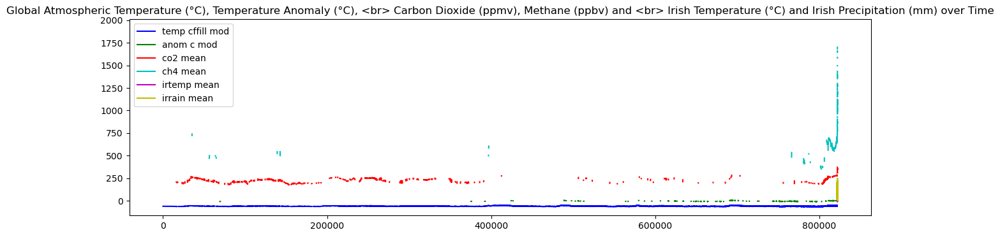

In [192]:
# px.scatter(df_all_var, x='year reset', 
#            y=df_all_var.drop(columns='year reset').columns, trendline='ols', width=600,
#            title = 'Global Atmospheric Temperature (°C), Temperature Anomaly (°C), <br> Carbon Dioxide (ppmv), Methane (ppbv) and <br> Irish Temperature (°C) and Irish Precipitation (mm) over Time'
#            ) 

# use plt to reduce notebook size

fig,ax = plt.subplots(figsize=(15, 4))
ax.plot(df_all_var['year reset'], 
        df_all_var['temp cffill mod'], 
        label='temp cffill mod', c='b')
ax.plot(df_all_var['year reset'], 
        df_all_var['anom c mod'], 
        label='anom c mod', c='g')
ax.plot(df_all_var['year reset'], 
        df_all_var['co2 mean'], 
        label='co2 mean', c='r')
ax.plot(df_all_var['year reset'], 
        df_all_var['ch4 mean'], 
        label='ch4 mean', c='c')
ax.plot(df_all_var['year reset'], 
        df_all_var['irtemp mean'], 
        label='irtemp mean', c='m')
ax.plot(df_all_var['year reset'], 
        df_all_var['irrain mean'], 
        label='irrain mean', c='y')
ax.legend()
ax.set_title("Global Atmospheric Temperature (°C), Temperature Anomaly (°C), <br> Carbon Dioxide (ppmv), Methane (ppbv) and <br> Irish Temperature (°C) and Irish Precipitation (mm) over Time");

Plot shows that there is an accelerated increase of CO<sub>2</sub>, temperature, temperature anomaly, CH<sub>4</sub> and Ireland's temperature and precipitation from the last 200 years. Because the levels are consistently increasing over that period, there is definitely a signal happening in the data, and not just some random effects of noise.

In [199]:
# Plot for 2018 to 2023 (821906 to 821911)

# px.scatter(df_all_var.tail(73), x='year reset', width=600,
#            y=df_all_var.drop(columns='year reset').columns, trendline='ols',
#            range_x=[821906, 821912], 
#            title = 'Global Atmospheric Temperature (°C), Temperature Anomaly (°C), <br> Carbon Dioxide (ppmv), Methane (ppbv) and <br> Irish Temperature (°C) and Precipitation (mm) from 2018 to 2023'
#            )

# fig,ax = plt.subplots(figsize=(15, 4))
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['temp cffill mod'],
#         label='temp cffill mod', c='b')
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['anom c mod'],
#         label='anom c mod', c='g')
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['co2 mean'],
#         label='co2 mean', c='r')
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['ch4 mean'],
#         label='ch4 mean', c='c')
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['irtemp mean'],
#         label='irtemp mean', c='m')
# ax.plot(df_all_var.tail(73)['year reset'], 
#         df_all_var.tail(73)['irrain mean'],
#         label='irrain mean', c='y')
# plt.xticks(821906, 821912, step=1)
# ax.legend()
# ax.set_title("Global Atmospheric Temperature (°C), Temperature Anomaly (°C), <br> Carbon Dioxide (ppmv), Methane (ppbv) and <br> Irish Temperature (°C) and Precipitation (mm) from 2018 to 2023");


TypeError: 'RangeIndex' object is not callable

There is no significant indication of accelerated warming based on data from the last 5 years only.

## 4.0 Conclusions

All data from CO<sub>2</sub>, temperature, temperature anomaly, CH<sub>4</sub> from 822kya to present and Ireland's temperature and precipitation were processed and merged into df_all.csv and df_all.json. 

A comparison between IPCC Report's CO<sub>2</sub> and Luthi et al. 2008 datasets shows that CO<sub>2</sub> dataset from Luthi et al. 2008 is not a subset of the IPCC Report and suggests the presence of gas age revision in IPCC Report.

Comparison of temperature data from Jouzel et al. (2007)-AICC and NOAA NCEI (2023b) found that the time (Gas age) adjustment in AICC2012 shifted the temperature values from 822kya to 400kya, while temperature and time from 400kya to present remain the same. A comparison of temperature and anomaly from the Jouzel-AICC and NOAA Dataset shows that the anomaly from Jouzel-AICC paper matches the anomaly from NOAA. 

Pearson Correlation results show that CO<sub>2</sub> has a high positive correlation with CH<sub>4</sub> and temperature, and a high negative correlation with Irish temperature. 

The Mann-Kendall Test shows significant increasing trends in CO<sub>2</sub>, temperature, temperature anomaly, CH<sub>4</sub>, while Ireland's temperature and precipitation show decreasing trends. 

Fast Fourier Transform (FFT) result shows that for CO<sub>2</sub>, CH<sub>4</sub> and temperature, there is a significant dominant frequency occuring every 10000 years and a lesser magnitude one every 25000 years. 

Multi-Seasonal Time Series Decomposition for Ireland's temperature and precipitation shows that the seasonal effect is consistently present, but shows weak seasonality. Ireland's temperature and precipitation have remained relatively constant over the years, and there are no clear systematic patterns or irregularities in the data after removing the trend and seasonal components. 

Ireland's Signal to Noise Ratio (SNR) for annual mean temperature shows that Ireland's temperature SNR at present are mostly categorised as "inconceivable" (SNR>5) when compared to the early‐industrial period of 1850 to 1900.

The Granger Causality Test indicates a a causal relationship between CO<sub>2</sub> and temperature, between temperature and CH<sub>04</sub>, and CO<sub>2</sub> correlates with a rise in CH<sub>4</sub>.

Autocorrelation Function (ACF) shows that current values are significantly influenced by its past values for temperature, CO<sub>2</sub> and CH<sub>4</sub> for lags up to 12000years, 15000 years and 11000 years, respectively. Partial Autocorrelation Function (PACF) values for temperature, CO<sub>2</sub> and CH<sub>4</sub> are statistically significant until lag=1000 years. The autocorrelation between Irish temperature and precipitation and their lagged versions decrease over time.

Time Lagged Cross-Correlation Analysis shows that CO<sub>2</sub> and temperature exhibit negative cross-correlation towards present time (temperature increase is followed by CO<sub>2</sub> increase), CO<sub>2</sub> and CH<sub>4</sub> exhibit stronger positive cross-correlation towards present time (CO<sub>2</sub> increase is followed by CH<sub>4</sub> increase) and temperature and CH<sub>4</sub> exhibit negative cross-correlation towards present time (CH<sub>4</sub> increase increase is followed by temperature increase). There is also a positive cross-correlation between Ireland's temperature and precipitation towards present time (temperature increase increase is followed by precipitation increase).

Global temperature anomaly prediction shows that global temperature anomaly will increase over time, if the atmospheric CO<sub>2</sub> trend keeps increasing. 

There is an accelerated increase of CO<sub>2</sub>, temperature, temperature anomaly, CH<sub>4</sub> and Ireland's temperature and precipitation over the last 200 years that is outside the normal range, which indicates that there's a signal happening in data and not just some random effects of noise. There is no indication of accelerated warming based solely on data from the last 5 years alone. 

In summary, evidence of climate change depends on the analysis being performed, the limit of settings within the analysis, the range of time period in the analysis, and the base period used for comparison.

## 5.0 References

* Adep , V. (2022). Time series correlation : Pearson, TLCC & DTW. [online] kaggle.com. Available at: https://www.kaggle.com/code/adepvenugopal/time-series-correlation-pearson-tlcc-dtw [Accessed 28 Dec. 2023].
* Anagnostou, E., John, E.H., Edgar, K.M., Foster, G.L., Ridgwell, A., Inglis, G.N., Pancost, R.D., Lunt, D.J. and Pearson, P.N. (2016). Changing atmospheric CO2 concentration was the primary driver of early Cenozoic climate. Nature, [online] 533(7603), pp.380–384. doi:https://doi.org/10.1038/nature17423.
* Antony, R. (2017). python - Pandas: change data type of Series to String. [online] Stack Overflow. Available at: https://stackoverflow.com/questions/22231592/pandas-change-data-type-of-series-to-string [Accessed 20 Dec. 2023].
* Araújo, A. (2017). Cross-correlation (time-lag) with pandas. [online] kaggle.com. Available at: https://www.kaggle.com/code/dedecu/cross-correlation-time-lag-with-pandas/notebook [Accessed 28 Dec. 2023].
* Bereiter, B., Eggleston, S., Schmitt, J., Nehrbass-Ahles, C., Stocker, T.F., Fischer, H., Kipfstuhl, S. and Chappellaz, J. (2015). Revision of the EPICA Dome C CO2
record from 800 to 600 kyr before present. Geophysical Research Letters, 42(2), pp.542–549. doi:https://doi.org/10.1002/2014gl061957.
* Berner, R.A. (1991). A model for atmospheric CO 2 over Phanerozoic time. American Journal of Science, 291(4), pp.339–376. doi:https://doi.org/10.2475/ajs.291.4.339.* 
* Bexgboost (2023). Advanced Time Series Analysis: Decomposition, .... [online] kaggle.com. Available at: https://www.kaggle.com/code/bextuychiev/advanced-time-series-analysis-decomposition [Accessed 6 Jan. 2024].
* Bhandari, B. (2023). Unlocking the Power of Fast Fourier Transform (FFT) with Python code. [online] www.linkedin.com. Available at: https://www.linkedin.com/pulse/unlocking-power-fast-fourier-transform-fft-python-bhandari-ph-d--3b0bc [Accessed 26 Dec. 2023].
* Bintanja, R., van de Wal, R.S.W. and Oerlemans, J. (2005). Modelled atmospheric temperatures and global sea levels over the past million years. Nature, 437(7055), pp.125–128. doi:https://doi.org/10.1038/nature03975.
* Brownlee, J. (2016). How To Resample and Interpolate Your Time Series Data With Python. [online] MachineLearningMastery.com. Available at: https://machinelearningmastery.com/resample-interpolate-time-series-data-python/ [Accessed 21 Dec. 2023].
* Brownlee, J. (2017). A Gentle Introduction to Autocorrelation and Partial Autocorrelation. [online] Machine Learning Mastery. Available at: https://machinelearningmastery.com/gentle-introduction-autocorrelation-partial-autocorrelation/ [Accessed 28 Dec. 2023].
* calmcode.io. (n.d.). Pandas Timestamp Limitations. [online] Available at: https://calmcode.io/til/pandas-timerange.html [Accessed 19 Dec. 2023].charlesreid1 (2019). Fast Fourier Transform in Python. [online] Stack Overflow. Available at: https://stackoverflow.com/questions/59172407/fast-fourier-transform-in-python [Accessed 26 Dec. 2023].
* Chen, D., Rojas, M., Samset, B.H., Cobb, K., Diongue Niang, A., Edwards, P., Emori, S., Faria, S.H., Hawkins, E., Hope, P., Huybrechts, P., Meinshausen, M., Mustafa, S.K., Plattner, G.-K. . and Tréguier, A.-M. . (2023). Framing, Context, and Methods. In Climate Change 2021: The Physical Science Basis. Contribution of Working Group I to the Sixth Assessment Report of the Intergovernmental Panel on Climate Change. Cambridge University Press eBooks, pp.147–286. doi:https://doi.org/10.1017/9781009157896.003.
* Chua, G. (2020). Chapter 7: Cross-Correlations, Fourier Transform, and Wavelet Transform — Time Series Analysis Handbook. [online] phdinds-aim.github.io. Available at: https://phdinds-aim.github.io/time_series_handbook/07_CrosscorrelationsFourierTransformandWaveletTransform/07_CrosscorrelationsFourierTransformandWaveletTransform.html [Accessed 29 Dec. 2023].
* Chugh, V. (2023). 3 Ways to Merge Pandas DataFrames. [online] KDnuggets. Available at: https://www.kdnuggets.com/2023/03/3-ways-merge-pandas-dataframes.html [Accessed 22 Dec. 2023].
* CIRES Education and Outreach at CU Boulder (n.d.). Ice-Albedo Feedback. [online] Available at: https://cires.colorado.edu/outreach/sites/default/files/2020-07/Teacher%20Guide%20-%20Ice-Albedo%20Feedback.pdf [Accessed 11 Dec. 2023].
* Das, chinmay (2019). Monitoring Global warming Linear Regression. [online] GitHub. Available at: https://github.com/chinmaydas96/Monitoring-Global-Warming-with-Linear-Regression [Accessed 3 Jan. 2024].
* Datatofish.com. (2021). How to Convert Strings to Floats in Pandas DataFrame – Data to Fish. [online] Available at: https://datatofish.com/convert-string-to-float-dataframe/ [Accessed 18 Dec. 2023].Davis, W. (2017). The Relationship between Atmospheric Carbon Dioxide Concentration and Global Temperature for the Last 425 Million Years. Climate, 5(4), p.76. doi:https://doi.org/10.3390/cli5040076.
* Davs2rt (2016). ValueError: DataFrame index must be unique for orient=‘columns’. [online] Stack Overflow. Available at: https://stackoverflow.com/questions/29271520/valueerror-dataframe-index-must-be-unique-for-orient-columns [Accessed 25 Dec. 2023].
* Docs.scipy.org fft. (n.d.). Fourier Transforms (scipy.fft) — SciPy v1.8.1 Manual. [online] Available at: https://docs.scipy.org/doc/scipy/tutorial/fft.html [Accessed 26 Dec. 2023].
* docs.scipy.org signal.correlate. (n.d.). scipy.signal.correlate — SciPy v1.7.0 Manual. [online] Available at: https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.correlate.html [Accessed 28 Dec. 2023].
* Dore, M.H.I. (2005). Climate change and changes in global precipitation patterns: What do we know? Environment International, 31(8), pp.1167–1181. doi:https://doi.org/10.1016/j.envint.2005.03.004.Duke.edu. (2019). Identifying the orders of AR and MA terms in an ARIMA model. [online] Available at: https://people.duke.edu/~rnau/411arim3.htm [Accessed 28 Dec. 2023].
* Ekwurzel, B., Boneham, J., Dalton, M.W., Heede, R., Mera, R.J., Allen, M.R. and Frumhoff, P.C. (2017). The rise in global atmospheric CO2, surface temperature, and sea level from emissions traced to major carbon producers. Climatic Change, 144(4), pp.579–590. doi:https://doi.org/10.1007/s10584-017-1978-0.
* ELmaghraby, E.K., Abu Khadra, S.A. and Eissa, H.S. (2016). Using the Fast Fourier Transform Technique for Climate Time Series Decomposition. Arab Journal of Nuclear Sciences and Applications, [online] 49(3). Available at: https://inis.iaea.org/search/search.aspx?orig_q=RN:47091653 [Accessed 31 Dec. 2023].
* Evangelista, A. (2023). Valueerror cannot insert level_0 already exists. [online] Itsourcecode.com. Available at: https://itsourcecode.com/valueerror/valueerror-cannot-insert-level_0-already-exists/ [Accessed 26 Dec. 2023].
* FasterCapital. (n.d.). Cross Correlation: Discovering Relationships between Time Series Variables. [online] Available at: https://fastercapital.com/content/Cross-Correlation--Discovering-Relationships-between-Time-Series-Variables.html [Accessed 28 Dec. 2023].
* Fathian, F., Dehghan, Z., Bazrkar, M.H. and Eslamian, S. (2016). Trends in hydrological and climatic variables affected by four variations of the Mann-Kendall approach in Urmia Lake basin, Iran. Hydrological Sciences Journal, 61(5), pp.1–13. doi:https://doi.org/10.1080/02626667.2014.932911.
* Fischer, H., Wahlen, M., Smith, J., Mastroianni, D. and Deck, B. (1999). Ice Core Records of Atmospheric CO2 Around the Last Three Glacial Terminations. Science, [online] 283(5408), pp.1712–1714. doi:https://doi.org/10.1126/science.283.5408.1712.
* Frost, J. (2021). Autocorrelation and Partial Autocorrelation in Time Series Data. [online] Statistics By Jim. Available at: https://statisticsbyjim.com/time-series/autocorrelation-partial-autocorrelation/ [Accessed 28 Dec. 2023].
* GeeksforGeeks . (2020). How to create a Triangle Correlation Heatmap in seaborn - Python? [online] Available at: https://www.geeksforgeeks.org/how-to-create-a-triangle-correlation-heatmap-in-seaborn-python/ [Accessed 27 Dec. 2023].
* GeeksforGeeks FFT. (2019). Python | Fast Fourier Transformation. [online] Available at: https://www.geeksforgeeks.org/python-fast-fourier-transformation/ [Accessed 26 Dec. 2023].GeeksforGeeks. (2018). Python | Pandas dataframe.resample(). [online] Available at: https://www.geeksforgeeks.org/python-pandas-dataframe-resample/ [Accessed 20 Dec. 2023].
* GeeksforGeeks. (2020). Applying Lambda functions to Pandas Dataframe. [online] Available at: https://www.geeksforgeeks.org/applying-lambda-functions-to-pandas-dataframe/ [Accessed 16 Dec. 2023].
* GeeksforGeeks. (2022). How to Perform a Mann-Kendall Trend Test in Python. [online] Available at: https://www.geeksforgeeks.org/how-to-perform-a-mann-kendall-trend-test-in-python/ [Accessed 27 Dec. 2023].
* Granato, G.E. (2006). Kendall-Theil Robust Line (KTRLine-version 1.0)- A Visual Basic Program for Calculating and Graphing Robust Nonparametric Estimates of Linear-Regression Coefficients Between Two Continuous Variables Techniques and Methods 4-A7. [online] Available at: https://pubs.usgs.gov/tm/2006/tm4a7/pdf/TM4-A7_KTRLine_report.pdf [Accessed 27 Dec. 2023].
* Hawkins, E., Frame, D., Harrington, L., Joshi, M., King, A., Rojas, M. and Sutton, R. (2020). Observed Emergence of the Climate Change Signal: From the Familiar to the Unknown. Geophysical Research Letters, 47(6). doi:https://doi.org/10.1029/2019gl086259.
* Hawkins, E., Ortega, P., Suckling, E., Schurer, A., Hegerl, G., Jones, P., Joshi, M., Osborn, T.J., Masson-Delmotte, V., Mignot, J., Thorne, P. and van Oldenborgh, G.J. (2017). Estimating Changes in Global Temperature since the Preindustrial Period. Bulletin of the American Meteorological Society, 98(9), pp.1841–1856. doi:https://doi.org/10.1175/bams-d-16-0007.1.
* Hertzberg, M. and Schreuder, H. (2016). Role of atmospheric carbon dioxide in climate change. Energy & Environment, 27(6-7), pp.785–797. doi:https://doi.org/10.1177/0958305x16674637.Higgins, P. (2023). Understanding the sens slope function in R: A guide to interpretation. [online] CopyProgramming. Available at: https://copyprogramming.com/howto/how-to-interpret-the-sens-slope-function-in-r#what-is-theil-sens-slope-estimator [Accessed 27 Dec. 2023].
* Hussain Shourov, M.M. (n.d.). pymannkendall: A python package for non-parametric Mann-Kendall family of trend tests. [online] PyPI. Available at: https://pypi.org/project/pymannkendall/ [Accessed 27 Dec. 2023].
* Hussain, F., Nabi, G. and Boota, M.W. (2015). Rainfall trend analysis by usimg the Mann-Kendall Test & Sen’s Slope Estimates: A case study of district Chakwal rain gauge, Barani area, Northern Punjab Province, Pakistan. Sci.Int.(Lahore), [online] 27(4), pp.3159–3165. Available at: https://www.researchgate.net/publication/330824269_RAINFALL_TREND_ANALYSIS_BY_USING_THE_MANN-KENDALL_TEST_SEN'S_SLOPE_ESTIMATES_A_CASE_STUDY_OF_DISTRICT_CHAKWAL_RAIN_GAUGE_BARANI_AREA_NORTHERN_PUNJAB_PROVINCE_PAKISTAN [Accessed 27 Dec. 2023].
* Hussain, Md. and Mahmud, I. (2019). pyMannKendall: a python package for non parametric Mann Kendall family of trend tests. Journal of Open Source Software, 4(39), p.1556. doi:https://doi.org/10.21105/joss.01556.icclim.readthedocs.io ecad. (n.d.). Examples — icclim 6.6.0 documentation. [online] Available at: https://icclim.readthedocs.io/en/latest/how_to/recipes_ecad.html [Accessed 6 Jan. 2024].
* Jabeen, A. (2023). Merge A List Of Pandas Dataframes Into A Single Dataframe In Python. [online] Entechin. Available at: https://www.entechin.com/merge-a-list-of-pandas-dataframes-into-a-single-dataframe-in-python/ [Accessed 22 Dec. 2023].
* Jain, I. (2023). Understanding Kendall’s Tau Rank Correlation. [online] Medium. Available at: https://ishanjainoffical.medium.com/understanding-kendalls-tau-rank-correlation-c959a7daea56 [Accessed 27 Dec. 2023].
* Jouzel, J., Masson-Delmotte, V., Cattani, O., Dreyfus, G., Falourd, S., Hoffmann, G., Minster, B., Nouet, J., Barnola, J.M., Chappellaz, J., Fischer, H., Gallet, J.C., Johnsen, S., Leuenberger, M., Loulergue, L., Luethi, D., Oerter, H., Parrenin, F., Raisbeck, G. and Raynaud, D. (2007). Orbital and Millennial Antarctic Climate Variability over the Past 800,000 Years. Science, 317(5839), pp.793–796. doi:https://doi.org/10.1126/science.1141038.Jouzel, J. and Masson‐Delmotte, V. (2007). EPICA Dome C Ice Core 800KYr deuterium data and temperature estimates. [online] doi:https://doi.org/10.1594/pangaea.683655.
* Kang, J. and Larsson, R. (2013). What is the link between temperature and carbon dioxide levels? A Granger causality analysis based on ice core data. Theoretical and Applied Climatology, 116(3-4), pp.537–548. doi:https://doi.org/10.1007/s00704-013-0960-7.
* Lan, X., Tans, P. and Thoning, K.W. (2023). Trends in globally-averaged CO2 determined from NOAA Global Monitoring Laboratory measurements. Version 2023-12. doi:https://doi.org/10.15138/9N0H-ZH07.
* Lan, X., Thoning, K.W. and Dlugokencky, E.J. (2023). Trends in globally-averaged CH4, N2O, and SF6 determined from NOAA Global Monitoring Laboratory measurements. doi:https://doi.org/10.15138/P8XG-AA10.
* Larsson, R. and Persson, E.K. (2023). What is the link between temperature, carbon dioxide and methane? A multivariate Granger causality analysis based on ice core data from Dome C in Antarctica. Theoretical and Applied Climatology, 153(1-2), pp.49–55. doi:https://doi.org/10.1007/s00704-023-04444-x.
* Liu, J., Ma, F.C., Chen, T.-L., Jiang, D., Du, M., Zhang, X., Feng, X., Wang, Q., Cao, J. and Wang, J. (2024). High-time resolution PM2.5 source apportionment assisted by spectrum-based characteristics analysis. Science of The Total Environment, 912, pp.169055–169055. doi:https://doi.org/10.1016/j.scitotenv.2023.169055.
* Loulergue, L., Schilt, A., Spahni, R., Masson-Delmotte, V., Blunier, T., Lemieux, B., Barnola, J.-M., Raynaud, D., Stocker, T.F. and Chappellaz, J. (2008). Orbital and millennial-scale features of atmospheric CH4 over the past 800,000 years. Nature, [online] 453(7193), pp.383–386. doi:https://doi.org/10.1038/nature06950.
* Lourantou, A., Lavrič, J.V., Köhler, P., Barnola, J.-M., Paillard, D., Michel, E., Raynaud, D. and Chappellaz, J. (2010). Constraint of the CO2rise by new atmospheric carbon isotopic measurements during the last deglaciation. Global Biogeochemical Cycles, 24(2), p.n/a-n/a. doi:https://doi.org/10.1029/2009gb003545.
* Lüthi, D., Le Floch, M., Bereiter, B., Blunier, T., Barnola, J.-M., Siegenthaler, U., Raynaud, D., Jouzel, J., Fischer, H., Kawamura, K. and Stocker, T.F. (2008). High-resolution carbon dioxide concentration record 650,000–800,000 years before present. Nature, 453(7193), pp.379–382. doi:https://doi.org/10.1038/nature06949.
* MacFarling Meure, C., Etheridge, D., Trudinger, C., Steele, P., Langenfelds, R., van Ommen, T., Smith, A. and Elkins, J. (2006). Law Dome CO2, CH4and N2O ice core records extended to 2000 years BP. Geophysical Research Letters, 33(14). doi:https://doi.org/10.1029/2006gl026152.
* MacLeod , C. (n.d.). Fourier Transforms With scipy.fft: Python Signal Processing – Real Python. [online] realpython.com. Available at: https://realpython.com/python-scipy-fft/ [Accessed 26 Dec. 2023].Mali, K. (2021). Linear Regression | Everything you need to Know about Linear Regression. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2021/10/everything-you-need-to-know-about-linear-regression/ [Accessed 2 Jan. 2024].
* Mallick, D. (2020). Interpreting ACF or Auto-correlation plot. [online] Analytics Vidhya. Available at: https://medium.com/analytics-vidhya/interpreting-acf-or-auto-correlation-plot-d12e9051cd14 [Accessed 28 Dec. 2023].
* Manani, K. (2022). Multi-Seasonal Time Series Decomposition using MSTL in Python. [online] Medium. Available at: https://towardsdatascience.com/multi-seasonal-time-series-decomposition-using-mstl-in-python-136630e67530 [Accessed 28 Dec. 2023].
* Mateus, C. (2021). Searching for historical meteorological observations in the Island of Ireland. Weather. doi:https://doi.org/10.1002/wea.3887.
* Mateus, C. and Potito, A. (2021). Development of a Quality-Controlled and Homogenised Long-Term Daily Maximum and Minimum Air Temperature Network Dataset for Ireland. Climate, 9(11), p.158. doi:https://doi.org/10.3390/cli9110158.
* Mateus, C. and Potito, A. (2022). Long-term trends in daily extreme air temperature indices in Ireland from 1885 to 2018. Weather and Climate Extremes, 36, p.100464. doi:https://doi.org/10.1016/j.wace.2022.100464.
* Mateus, C., Potito, A. and Curley, M. (2020a). Engaging secondary school students in climate data rescue through service‐learning partnerships. Weather. doi:https://doi.org/10.1002/wea.3841.
* Mateus, C., Potito, A. and Curley, M. (2020b). Reconstruction of a long‐term historical daily maximum and minimum air temperature network dataset for Ireland (1831‐1968). Geoscience Data Journal, 7(2), pp.102–115. doi:https://doi.org/10.1002/gdj3.92.
* matplotlib.org bar . (n.d.). matplotlib.pyplot.bar — Matplotlib 3.4.3 documentation. [online] Available at: https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.bar.html [Accessed 1 Jan. 2024].
* matplotlib.org legend. (n.d.). matplotlib.pyplot.legend — Matplotlib 3.3.4 documentation. [online] Available at: https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.legend.html [Accessed 1 Jan. 2024].
* matplotlib.org scatter. (n.d.). matplotlib.pyplot.scatter — Matplotlib 3.5.1 documentation. [online] Available at: https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.scatter.html [Accessed 1 Jan. 2024].
* Met Eireann (2019). Historical Data - Met Éireann - The Irish Meteorological Service. [online] Www.met.ie. Available at: https://www.met.ie/climate/available-data/historical-data [Accessed 13 Dec. 2023].
* methods-sagepub-com-christuniversity.knimbus.com. (2016). Learn About Time Series Cross-Correlations in SPSS With Data From the USDA Feed Grains Database (1876–2015). [online] Available at: https://methods-sagepub-com-christuniversity.knimbus.com/dataset/download/time-series-cross-correlations-in-us-feedgrains-1876-2015/student-guide [Accessed 28 Dec. 2023].
* Mishra, S. (2021). Resample function of Pandas. [online] Medium. Available at: https://towardsdatascience.com/resample-function-of-pandas-79b17ec82a78 [Accessed 20 Dec. 2023].
* Monnin, E., Indermühle, A., Dällenbach, A., Flückiger, J., Stauffer, B., Stocker, T.F., Raynaud, D. and Barnola, ean-Marc (2001). Atmospheric CO2 Concentrations over the Last Glacial Termination. Science, 291(5501), pp.112–114. doi:https://doi.org/10.1126/science.291.5501.112.Moro, P.G.F. (2021). Data Science in Climate Change. [online] Analytics Vidhya. Available at: https://medium.com/analytics-vidhya/data-science-in-climate-change-7ba2dd948aa7 [Accessed 28 Dec. 2023].
* Murphy, C., Broderick, C., Burt, T.P., Curley, M., Duffy, C., Hall, J., Harrigan, S., Matthews, T., Macdonald, N., McCarthy, G., McCarthy, M., Mullan, D., Noone, S., Osborn, T., Ryan, C., Sweeney, J., Thorne, P., Walsh, S. and Wilby, R.L. (2018a). Island of Ireland monthly rainfall series 1711-2016 (IoI_1711). PANGAEA. doi:https://doi.org/10.1594/pangaea.887593.
* Murphy, C., Broderick, C., Burt, T.P., Curley, M., Duffy, C., Hall, J., Harrigan, S., Matthews, T.K.R., Macdonald, N., McCarthy, G., McCarthy, M.P., Mullan, D., Noone, S., Osborn, T.J., Ryan, C., Sweeney, J., Thorne, P.W., Walsh, S. and Wilby, R.L. (2018b). A 305-year continuous monthly rainfall series for the island of Ireland (1711–2016). Climate of the Past, 14(3), pp.413–440. doi:https://doi.org/10.5194/cp-14-413-2018.
* Murphy, C., Coen, A., Clancy, I., Decristoforo, V., Cathal, S., Healion, K., Horvath, C., Jessop, C., Kennedy, S., Lavery, R., Leonard, K., McLoughlin, C., Moore, R., O’Hare-Doherty, D., Paisley, R., Prakash, B., Vatu, J., Thorne, P., Mateus, C. and Ryan, C. (2023a). The emergence of a climate change signal in long-term Irish meteorological observations. Weather and Climate Extremes, [online] 42, p.100608. doi:https://doi.org/10.1016/j.wace.2023.100608.
* Murphy, C., Kettle, A.J., Hadush Meresa, Golian, S., Bruen, M., Fiachra O’Loughlin and Per‐Erik Mellander (2023b). Climate Change Impacts on Irish River Flows: High Resolution Scenarios and Comparison with CORDEX and CMIP6 Ensembles. Water Resources Management, 37(5), pp.1841–1858. doi:https://doi.org/10.1007/s11269-023-03458-4.
* NASA (2023a). The effects of climate change. [online] Global Climate Change: Vital Signs of the Planet. Available at: https://climate.nasa.gov/effects/ [Accessed 11 Dec. 2023].
* NASA (2023b). What Is Climate Change? [online] Climate Change: Vital Signs of the Planet. Available at: https://climate.nasa.gov/what-is-climate-change/ [Accessed 11 Dec. 2023].
* Nik (2023). Pandas read_csv() - Read CSV and Delimited Files in Pandas • datagy. [online] Datagy read_csv(). Available at: https://datagy.io/pandas-read_csv/ [Accessed 20 Dec. 2023].
* Nikhase (2017). What’s the difference between pandas ACF and statsmodel ACF? [online] Stack Overflow. Available at: https://stackoverflow.com/questions/36038927/whats-the-difference-between-pandas-acf-and-statsmodel-acf [Accessed 29 Dec. 2023].
* NOAA (2023). Global Monitoring Laboratory - Carbon Cycle Greenhouse Gases. [online] gml.noaa.gov. Available at: https://gml.noaa.gov/ccgg/trends/ [Accessed 11 Dec. 2023].
* NOAA NCEI (2023a). Annual 2022 global climate report | national centers for environmental Information (NCEI). [online] www.ncei.noaa.gov. Available at: https://www.ncei.noaa.gov/access/monitoring/monthly-report/global/202213 [Accessed 17 Dec. 2023].
* NOAA NCEI (2023b). Climate at a Glance: Global Time Series | National Centers for Environmental Information (NCEI). [online] www.ncei.noaa.gov. Available at: https://www.ncei.noaa.gov/access/monitoring/climate-at-a-glance/global/time-series [Accessed 17 Dec. 2023].
* NOAA NCEI (n.d.). EPICA Dome C - 800KYr Deuterium Data and Temperature Estimates. [online] www.ncei.noaa.gov. Available at: https://www.ncei.noaa.gov/access/paleo-search/study/6080 [Accessed 14 Dec. 2023].
* Noone, S., Murphy, C., Coll, J., Matthews, T., Mullan, D., Wilby, R.L. and Walsh, S. (2016). Homogenization and analysis of an expanded long-term monthly rainfall network for the Island of Ireland (1850-2010). International Journal of Climatology, 36(8), pp.2837–2853. doi:https://doi.org/10.1002/joc.4522.
* numpy.org fft. (n.d.). numpy.fft.fft — NumPy v2.0.dev0 Manual. [online] Available at: https://numpy.org/devdocs/reference/generated/numpy.fft.fft.html [Accessed 29 Dec. 2023].
* Numpy.org numpy.negative. (n.d.). numpy.negative — NumPy v1.26 Manual. [online] Available at: https://numpy.org/doc/stable/reference/generated/numpy.negative.html [Accessed 14 Dec. 2023].
* online.stat.psu.edu. (n.d.). T.2.1 - Autoregressive Models. [online] Available at: https://online.stat.psu.edu/stat501/book/export/html/996 [Accessed 28 Dec. 2023].Package ‘VLTimeCausality’. (2022). doi:https://doi.org/10.1145/3441452%3E.
* Padav, P. (2021). Granger Causality in Time Series Explained with Chicken and Egg problem. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2021/08/granger-causality-in-time-series-explained-using-chicken-and-egg-problem/ [Accessed 28 Dec. 2023].
* Palvel, S. (2023). Exploring Time Series Decomposition Methods. [online] Medium. Available at: https://subashpalvel.medium.com/exploring-time-series-decomposition-methods-967833b68e15 [Accessed 28 Dec. 2023].
* Pandas.pydata.org .corr. (n.d.). pandas.DataFrame.corr — pandas 1.3.2 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.corr.html [Accessed 27 Dec. 2023].
* Pandas.pydata.org .to_csv . (n.d.). pandas.DataFrame.to_csv — pandas 1.2.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_csv.html [Accessed 25 Dec. 2023].
* Pandas.pydata.org astype. (n.d.). pandas.DataFrame.astype — pandas 1.4.2 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.astype.html [Accessed 18 Dec. 2023].
* Pandas.pydata.org autocorrelation_plot . (n.d.). pandas.plotting.autocorrelation_plot — pandas 2.1.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.plotting.autocorrelation_plot.html [Accessed 29 Dec. 2023].
* Pandas.pydata.org concat. (n.d.). pandas.concat — pandas 1.3.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.concat.html [Accessed 14 Dec. 2023].
* Pandas.pydata.org drop_duplicates . (n.d.). pandas.DataFrame.drop_duplicates — pandas 1.2.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.drop_duplicates.html [Accessed 24 Dec. 2023].
* Pandas.pydata.org ffill. (n.d.). pandas.DataFrame.ffill — pandas 1.4.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.ffill.html [Accessed 20 Dec. 2023].
* Pandas.pydata.org iloc. (n.d.). pandas.DataFrame.iloc — pandas 1.3.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.iloc.html [Accessed 14 Dec. 2023].
* Pandas.pydata.org mean. (n.d.). pandas.DataFrame.mean — pandas 1.3.5 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.mean.html [Accessed 16 Dec. 2023].
* Pandas.pydata.org merge. (n.d.). Merge, join, and concatenate — pandas 0.20.3 documentation. [online] Available at: https://pandas.pydata.org/pandas-docs/version/0.20/merging.html [Accessed 22 Dec. 2023].
* Pandas.pydata.org merge. (n.d.). pandas.DataFrame.merge — pandas 1.3.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.merge.html [Accessed 15 Dec. 2023].
* Pandas.pydata.org Period. (n.d.). pandas.Period — pandas 2.1.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.Period.html [Accessed 16 Dec. 2023].
* Pandas.pydata.org read_csv. (n.d.). pandas.read_csv — Pandas 1.2.4 Documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.read_csv.html [Accessed 20 Dec. 2023].
* Pandas.pydata.org rename. (n.d.). pandas.DataFrame.rename — pandas 1.4.2 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.rename.html [Accessed 14 Dec. 2023].
* Pandas.pydata.org resample. (n.d.). pandas.DataFrame.resample — pandas 1.5.1 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.resample.html [Accessed 18 Dec. 2023].
* Pandas.pydata.org Series.str.split . (n.d.). pandas.Series.str.split — pandas 1.3.0 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.Series.str.split.html [Accessed 18 Dec. 2023].
* Pandas.pydata.org set_index. (n.d.). pandas.DataFrame.set_index — pandas 1.2.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.set_index.html [Accessed 16 Dec. 2023].
* Pandas.pydata.org sort_values. (n.d.). pandas.DataFrame.sort_values — pandas 1.4.1 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.sort_values.html [Accessed 16 Dec. 2023].
* Pandas.pydata.org Time series. (n.d.). Time series / date functionality — pandas 1.2.3 documentation. [online] Available at: https://pandas.pydata.org/docs/user_guide/timeseries.html [Accessed 17 Dec. 2023].
* Pandas.pydata.org to_datetime. (n.d.). pandas.to_datetime — pandas 1.3.4 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.to_datetime.html [Accessed 20 Dec. 2023].
* Pandas.pydata.org to_json. (n.d.). pandas.DataFrame.to_json — pandas 1.4.2 documentation. [online] Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_json.html [Accessed 25 Dec. 2023].
* Parrenin, F., Dreyfus, G., Durand, G., Fujita, S., Gagliardini, O., Gillet, F., Jouzel, J., Kawamura, K., Lhomme, N., Masson-Delmotte, V., Ritz, C., Schwander, J., Shoji, H., Uemura, R., Watanabe, O. and Yoshida, N. (2007). 1-D-ice flow modelling at EPICA Dome C and Dome Fuji, East Antarctica. Climate of the Past, 3(2), pp.243–259. doi:https://doi.org/10.5194/cp-3-243-2007.
* Parrenin, F., Masson-Delmotte, V., Kohler, P., Raynaud, D., Paillard, D., Schwander, J., Barbante, C., Landais, A., Wegner, A. and Jouzel, J. (2013). Synchronous Change of Atmospheric CO2 and Antarctic Temperature During the Last Deglacial Warming. Science, [online] 339(6123), pp.1060–1063. doi:https://doi.org/10.1126/science.1226368.
* Petit, J.R., Jouzel, J., Raynaud, D., Barkov, N.I., Barnola, J.-M. ., Basile, I., Bender, M., Chappellaz, J., Davis, M., Delaygue, G., Delmotte, M., Kotlyakov, V.M., Legrand, M., Lipenkov, V.Y., Lorius, C., PÉpin, L., Ritz, C., Saltzman, E. and Stievenard, M. (1999). Climate and atmospheric history of the past 420,000 years from the Vostok ice core, Antarctica. Nature, 399(6735), pp.429–436. doi:https://doi.org/10.1038/20859.
* Plotly Community Forum. (2019). dcc.Graph: how to split the title on several rows / force break line. [online] Available at: https://community.plotly.com/t/dcc-graph-how-to-split-the-title-on-several-rows-force-break-line/26369 [Accessed 8 Jan. 2024].
* plotly.com Bar Charts. (n.d.). Bar Charts. [online] Available at: https://plotly.com/python/bar-charts/ [Accessed 7 Jan. 2024].Plotly.com express.scatter . (n.d.). plotly.express.scatter — 5.18.0 documentation. [online] Available at: https://plotly.com/python-api-reference/generated/plotly.express.scatter.html [Accessed 15 Dec. 2023].
* plotly.com Horizontal. (n.d.). Horizontal. [online] Available at: https://plotly.com/python/horizontal-vertical-shapes/ [Accessed 6 Jan. 2024].
* plotly.com linear-fits. (n.d.). Linear. [online] Available at: https://plotly.com/python/linear-fits/ [Accessed 4 Jan. 2024].
* Plotly.com Scatter Plots. (n.d.). Scatter Plots. [online] Available at: https://plotly.com/python/line-and-scatter/ [Accessed 15 Dec. 2023].
* Prabhakaran, S. (2022). Granger Causality Test in Python. [online] Machine Learning Plus. Available at: https://www.machinelearningplus.com/time-series/granger-causality-test-in-python/ [Accessed 28 Dec. 2023].
* projects.scipy.org. (n.d.). Installation — SciPy.org. [online] Available at: https://projects.scipy.org/install.html [Accessed 28 Dec. 2023].
* Quora. (2023). Why do we represent signals in the frequency domain or compute their Fourier transform? [online] Available at: https://www.quora.com/Why-do-we-represent-signals-in-the-frequency-domain-or-compute-their-Fourier-transform [Accessed 31 Dec. 2023].
* Rajaram, A. (2021). Mann Kendall Test in Python for Trend Detection. [online] Medium. Available at: https://abhinaya-sridhar-rajaram.medium.com/mann-kendall-test-in-python-for-trend-detection-in-time-series-bfca5b55b [Accessed 27 Dec. 2023].
* Rhodes, R.H., Faïn, X., Stowasser, C., Blunier, T., Chappellaz, J., McConnell, J.R., Romanini, D., Mitchell, L.E. and Brook, E.J. (2013). Continuous methane measurements from a late Holocene Greenland ice core: Atmospheric and in-situ signals. Earth and Planetary Science Letters, [online] 368, pp.9–19. doi:https://doi.org/10.1016/j.epsl.2013.02.034.
* Riebeek, H. (2010). Global Warming. [online] Nasa. Available at: https://earthobservatory.nasa.gov/features/GlobalWarming [Accessed 11 Dec. 2023].
* Rubino, M., Etheridge, D.M., Thornton, D.P., Howden, R., Allison, C.E., Francey, R.J., Langenfelds, R.L., Steele, L.P., Trudinger, C.M., Spencer, D.A., Curran, M.A.J., van Ommen, T.D. and Smith, A.M. (2019). Revised records of atmospheric trace gases  CO2, CH4, N2O, and δ13C-CO2 over the last  2000 years from Law Dome, Antarctica. Earth System Science Data, 11(2), pp.473–492. doi:https://doi.org/10.5194/essd-11-473-2019.
* Ryan, C., Murphy, C., McGovern, R., Curley, M. and Walsh, S. (2020). Ireland’s pre‐1940 daily rainfall records. Geoscience Data Journal, 8(1), pp.11–23. doi:https://doi.org/10.1002/gdj3.103.
* Sarker, R. (2023). Mann-Kendall Trend Test Using Python. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2023/07/mann-kendall-trend-test-using-python/ [Accessed 27 Dec. 2023].
* Sharma, A. (2020). Learn How to Use Lambda Functions in Python Easily and Effectively. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2020/03/what-are-lambda-functions-in-python/#What_Are_Lambda_Functions? [Accessed 17 Dec. 2023].
* Spahni, R., Chappellaz, J., Stocker, T.F., Loulergue, L., Hausammann, G., Kawamura, K., Fluckiger, J., Schwander, J., Raynaud, D., Masson-Delmotte, V. and Jouzel, J. (2005). Atmospheric Methane and Nitrous Oxide of the Late Pleistocene from Antarctic Ice Cores. Science, 310(5752), pp.1317–1321. doi:https://doi.org/10.1126/science.1120132.Spencer, V. (2023). Using cross-correlation to determine time series lag. [online] copyprogramming.com. Available at: https://copyprogramming.com/howto/how-to-find-the-lag-between-two-time-series-using-cross-correlation [Accessed 28 Dec. 2023].
* stackoverflow.com (2016). Cross-correlation (time-lag-correlation) with pandas? [online] Stack Overflow. Available at: https://stackoverflow.com/questions/33171413/cross-correlation-time-lag-correlation-with-pandas [Accessed 29 Dec. 2023].
* Statistics How To. (2016). Mann Kendall Trend Test: Definition, Running the Test. [online] Available at: https://www.statisticshowto.com/mann-kendall-trend-test/ [Accessed 27 Dec. 2023].
* Statistics Solutions (2021). Pearson’s Correlation Coefficient. [online] Statistics Solutions. Available at: https://www.statisticssolutions.com/free-resources/directory-of-statistical-analyses/pearsons-correlation-coefficient/ [Accessed 21 Nov. 2023].
* Stratis, K. (n.d.). Combining Data in Pandas With merge(), .join(), and concat() – Real Python. [online] realpython.com. Available at: https://realpython.com/pandas-merge-join-and-concat/ [Accessed 22 Dec. 2023].
* SunPy. (n.d.). Transition from datetime to astropy.time. [online] Available at: https://sunpy.org/posts/2018/2018-10-20-time [Accessed 19 Dec. 2023].
* Szulejko, J.E., Kumar, P., Deep, A. and Kim, K.-H. (2017). Global warming projections to 2100 using simple CO 2 greenhouse gas modeling and comments on CO 2 climate sensitivity factor. Atmospheric Pollution Research, 8(1), pp.136–140. doi:https://doi.org/10.1016/j.apr.2016.08.002.
* Understanding Global Change. (n.d.). Atmospheric circulation. [online] Available at: https://ugc.berkeley.edu/background-content/atmospheric-circulation/ [Accessed 11 Dec. 2023].
* United Nations (2023). What Is Climate change? [online] Climate Action. Available at: https://www.un.org/en/climatechange/what-is-climate-change [Accessed 11 Dec. 2023].
* United States Environmental Protection Agency (2017). Greenhouse Gases | US EPA. [online] US EPA. Available at: https://www.epa.gov/report-environment/greenhouse-gases [Accessed 11 Dec. 2023].
* Weckesser, W. (2015). How to filter/smooth with SciPy/Numpy? [online] Stack Overflow. Available at: https://stackoverflow.com/questions/28536191/how-to-filter-smooth-with-scipy-numpy [Accessed 6 Jan. 2024].
* Wikipedia Contributors (2019). Pearson correlation coefficient. [online] Wikipedia. Available at: https://en.wikipedia.org/wiki/Pearson_correlation_coefficient [Accessed 21 Nov. 2023].
* Wikipedia. (2023). Effects of climate change on the water cycle. [online] Available at: https://en.wikipedia.org/wiki/Effects_of_climate_change_on_the_water_cycle [Accessed 11 Dec. 2023].
* www.ces.fau.edu. (n.d.). Climate Science Investigations South Florida - Energy: The Driver of Climate. [online] Available at: https://www.ces.fau.edu/nasa/module-2/how-greenhouse-effect-works.php [Accessed 11 Dec. 2023].
* www.eea.europa.eu. (n.d.). Extreme weather: floods, droughts and heatwaves. [online] Available at: https://www.eea.europa.eu/en/topics/in-depth/extreme-weather-floods-droughts-and-heatwaves [Accessed 11 Dec. 2023].
* www.statsmodels.org LOWESS Smoother. (n.d.). LOWESS Smoother - statsmodels 0.15.0 (+197). [online] Available at: https://www.statsmodels.org/dev/examples/notebooks/generated/lowess.html [Accessed 6 Jan. 2024].
* www.statsmodels.org lowess. (n.d.). statsmodels.nonparametric.smoothers_lowess.lowess — statsmodels. [online] Available at: https://www.statsmodels.org/devel/generated/statsmodels.nonparametric.smoothers_lowess.lowess.html [Accessed 6 Jan. 2024].
* www.statsmodels.org seasonal_decom. (n.d.). statsmodels.tsa.seasonal.seasonal_decompose — statsmodels. [online] Available at: https://www.statsmodels.org/dev/generated/statsmodels.tsa.seasonal.seasonal_decompose.html [Accessed 30 Dec. 2023].
* www.statsmodels.org tsaplots.plot_acf . (n.d.). statsmodels.graphics.tsaplots.plot_acf - statsmodels 0.14.0. [online] Available at: https://www.statsmodels.org/stable/generated/statsmodels.graphics.tsaplots.plot_acf.html [Accessed 29 Dec. 2023].
* www.statsmodels.org tsaplots.plot_pacf. (n.d.). statsmodels.graphics.tsaplots.plot_pacf - statsmodels 0.15.0 (+132). [online] Available at: https://www.statsmodels.org/devel/generated/statsmodels.graphics.tsaplots.plot_pacf.html [Accessed 29 Dec. 2023].
* www.statsmodels.org. (n.d.). statsmodels.tsa.stattools.grangercausalitytests — statsmodels. [online] Available at: https://www.statsmodels.org/stable/generated/statsmodels.tsa.stattools.grangercausalitytests.html [Accessed 28 Dec. 2023].
* Zach (2021). How to Perform a Mann-Kendall Trend Test in Python. [online] Statology. Available at: https://www.statology.org/mann-kendall-test-python/ [Accessed 27 Dec. 2023].

***

## End of Project 2